In [1]:
%matplotlib inline
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 200
import matplotlib.colors as colors
import torch
import torch.nn as nn
import torch.optim as optim
import copy

In [2]:
# trial data
data = np.load('sample_photostim_0113.npy', allow_pickle = True).item()
y = data['y']
u = data['u']
num_trials = y.shape[0]
num_steps = y.shape[1]
num_neurons = y.shape[2]
T_before = 4
T_after_start = 9
T_after_end = 13
y_before = np.mean(y[:,:T_before,:],axis = 1)
y_after = np.mean(y[:,T_after_start:T_after_end,:],axis = 1)

y_session = data['y_session']
u_session = data['u_session']

# linear interpolation of data
y_session_interp = y_session.copy()
for i in range(y_session.shape[1]):
    nan_start = -1
    nan_stop = -1
    for j in range(y_session.shape[0]):
        if nan_start == -1 and np.isnan(y_session_interp[j,i]):
            nan_start = j - 1
        if nan_start != -1 and not np.isnan(y_session_interp[j,i]):
            nan_stop = j
        if nan_start != -1 and nan_stop != -1:
            slope = y_session_interp[nan_stop,i] - y_session_interp[nan_start,i]
            for k in range(nan_stop - nan_start - 1):
                y_session_interp[nan_start + k + 1,i] = slope*k/(nan_stop-nan_start-1) + y_session_interp[nan_start,i]
            nan_start = -1
            nan_stop = -1
            
# y_session = y_session[4:,:]
# u_session = u_session[4:,:]
# y_session_interp = y_session_interp[4:,:]

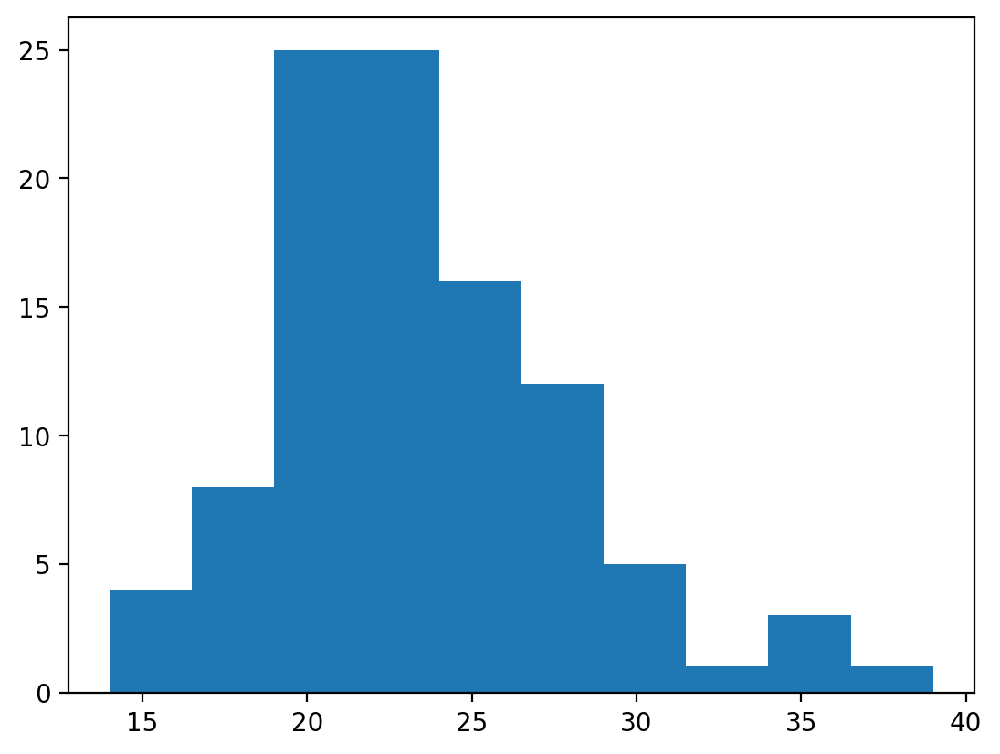

In [46]:
patterns = []
pattern_count = []
pattern_idx = []
pattern_length = []

start = -10
for t in range(u_session.shape[0]):
    if np.sum(np.abs(u_session[t,:])) > 0 and t > start + 4:
        idx = np.linspace(0,663-1,663).astype(int)
        on = u_session[t,:] > 0
        pattern = np.array(idx[on])
        start = t
        found = False
        for i in range(len(patterns)):
            if len(pattern) == len(patterns[i]):
                if np.linalg.norm(pattern - patterns[i]) == 0:
                    pattern_count[i] += 1
                    pattern_idx[i].append(t)
                    found = True
                    break
        if found is False:
            patterns.append(pattern)
            pattern_count.append(1)
            pattern_idx.append([t])
            pattern_length.append(len(pattern))

neuron_pattern = np.zeros(663)
for i in range(663):
    for p in patterns:
        if i in p:
            neuron_pattern[i] += 1

plt.hist(pattern_count)
plt.show()

In [134]:
print(len(patterns))

100


120 0.22870540749094795
5


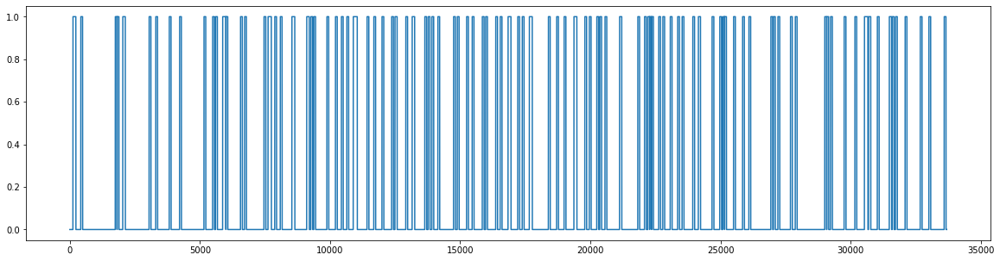

In [57]:
# remove patterns by neuron

num_neurons = 5
removed_patterns = []
excluded_patterns = []
removed_neurons = []
removed_steps = np.zeros(u_session.shape[0])
removed_count = 0

while len(removed_neurons) < num_neurons:
    neuron = np.random.randint(0,663)
    if neuron not in removed_neurons and neuron_pattern[neuron] > 1:
        removed_neurons.append(neuron)
        removed = False
        for p_idx in range(len(patterns)):
            if neuron in patterns[p_idx] and p_idx not in removed_patterns and p_idx not in excluded_patterns and removed is False:
                removed_patterns.append(p_idx)
                removed_count += pattern_count[p_idx]
                for i in pattern_idx[p_idx]:
                    min_idx = np.max([0,i-20])
                    max_idx = np.min([i+50,u_session.shape[0]-1])
                    removed_steps[min_idx:max_idx] = 1
                removed = True
            if neuron in patterns[p_idx] and p_idx not in removed_patterns and p_idx not in excluded_patterns and removed is True:
                excluded_patterns.append(p_idx)
            
                
print(removed_count, np.sum(removed_steps) / u_session.shape[0])
print(len(removed_patterns))
plt.figure(figsize=(20,5))
plt.plot(removed_steps)
plt.show()

test_indices = removed_steps.astype(int)
train_indices = np.ones(test_indices.shape[0]).astype(int) - test_indices.copy()

125 0.23295151047539914
5


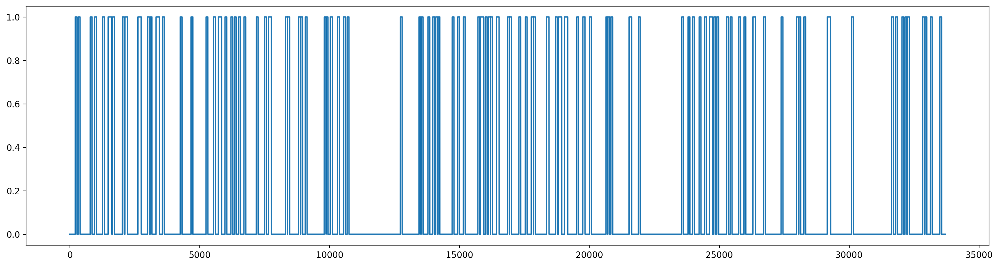

In [59]:
# remove patterns randomly

num_patterns = 5
removed_patterns = []
removed_neurons = []
removed_steps = np.zeros(u_session.shape[0])
removed_count = 0
removed_steps2 = np.zeros(u_session.shape[0])

removed_patterns = [44, 50, 15, 64, 23]

#while len(removed_patterns) < num_patterns:
for p_idx in removed_patterns:
    #p_idx = np.random.randint(0,len(patterns))
    #if p_idx not in removed_patterns:
    if True:
        #removed_patterns.append(p_idx)
        removed_count += pattern_count[p_idx]
        removed_neurons.extend(patterns[p_idx])
        for i in pattern_idx[p_idx]:
            min_idx = np.max([0,i-20])
            max_idx = np.min([i+50,u_session.shape[0]-1])
            removed_steps[min_idx:max_idx] = 1
            
            min_idx = np.max([0,i-5])
            max_idx = np.min([i+10,u_session.shape[0]-1])
            removed_steps2[min_idx:max_idx] = 1
            
                
print(removed_count, np.sum(removed_steps) / u_session.shape[0])
print(len(removed_patterns))
plt.figure(figsize=(20,5))
plt.plot(removed_steps)
plt.show()

test_indices = removed_steps.astype(int)
test_indices2 = removed_steps2.astype(int)
train_indices = np.ones(test_indices.shape[0]).astype(int) - test_indices.copy()
removed_neurons = list(set(removed_neurons))

# train_test_split = {}
# train_test_split['train_indices'] = train_indices
# train_test_split['test_indices'] = test_indices
# np.save('train_test_split',train_test_split)

In [55]:
np.random.randint(0,len(patterns),5)

array([44, 50, 15, 64, 23])

In [38]:
spiking = np.zeros(u_session.shape).astype(bool)

for neuron in range(u_session.shape[1]):
    output_true = y_session_interp[4:,neuron]
    mean_threshold = np.median(output_true)
    lower_tail_idx = (output_true < mean_threshold)
    lower_tail_data = output_true[lower_tail_idx]
    lower_tail_std = np.std(lower_tail_data)
    print(lower_tail_std)
    true_spike_threshold = mean_threshold + 6*lower_tail_std
    true_spikes = (output_true > true_spike_threshold)
    spiking[4:,neuron] = true_spikes  
    
np.save('spiking_labels',spiking)

10.926305
6.8637924
10.2582035
8.80526
9.282541
10.277796
19.47125
8.010129
6.368451
12.515049
8.127925
7.872719
9.254664
9.460864
6.900674
6.7014256
13.435938
13.280504
5.815727
5.553677
7.1259336
7.792279
13.807764
8.649218
10.296269
10.225375
10.375469
13.5954075
10.399429
7.4910517
6.2267127
6.7933927
9.528945
6.36728
10.152898
5.5899534
11.161926
8.639719
4.9650493
6.7699227
7.3379025
9.040896
7.3271065
11.73246
13.986362
9.226959
8.180463
5.7991967
9.400248
13.124448
11.497623
5.844215
10.059646
9.304157
9.6105795
5.063303
7.6047525
6.7856374
7.1048026
10.863687
8.672426
12.873427
5.566862
9.275431
11.061833
6.51319
8.993106
5.0163984
5.834947
9.683207
7.2687974
11.5129175
11.0101385
9.233922
10.026835
11.600518
9.963518
11.38672
7.4664526
10.166133
9.710266
9.179704
15.667917
5.734885
7.3031383
8.293233
14.334215
7.272676
8.916961
10.608227
11.324754
11.225982
7.0736065
10.678194
11.547289
9.894718
8.6037245
10.13237
7.8902493
13.090778
5.7624125
13.112546
8.051336
8.795618
8.71

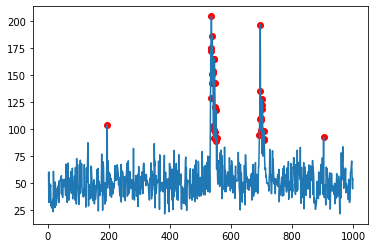

In [36]:
neuron = 206
T = 1000
plt.plot(y_session_interp[:T,neuron])
idx = np.linspace(0,T-1,T)
spiking_neuron = spiking[:T,neuron]
y_out = y_session_interp[0:T,neuron].copy()
y_out = y_out * spiking_neuron
y_out[y_out == 0] = np.nan
plt.scatter(idx,y_out,color='r')  
plt.show()

In [3]:
split = np.load('../train_test_split.npy', allow_pickle=True).item()
train_indices = split['train_indices']
test_indices = split['test_indices']

# Train Model

In [4]:
ark_order = 3
X = []
Xp = []
for t in range(train_indices.shape[0]-ark_order):
    if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        X.append(np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
        Xp.append(y_session_interp[t+ark_order,:].copy().flatten() / 1000)
X = np.array(X)
Xp = np.array(Xp)
Ahat = np.linalg.pinv(X.T @ X) @ X.T @ Xp
Ahat = Ahat.T
#np.save('ARk5_gt', Ahat)

In [5]:
x_pred = []
x_true = []
u_true = []
idx = -1

new_segment = True
segment_pred = []
segment_start = -1
for t in range(train_indices.shape[0]):
    if test_indices[t] == 1:
        if new_segment:
            segment_pred = []
            new_segment = False
            segment_start = t
            x_past = []
            x_pred.append([])
            x_true.append([])
            u_true.append([])
            idx += 1
        if t < segment_start + ark_order:
            x_past.append(y_session_interp[t,:].copy().flatten() / 1000)
        else:
            z = np.array(x_past).flatten()
            z = np.concatenate((z,u_session[t-ark_order:t,:].copy().flatten(),np.ones(1)))
            x_next = Ahat @ z
            x_past.pop(0)
            x_past.append(x_next.copy())
            x_pred[idx].append(x_next.copy())
            x_true[idx].append(y_session_interp[t,:].copy().flatten() / 1000)
            u_true[idx].append(u_session[t,:].copy().flatten())
    else:
        new_segment = True

for i in range(len(x_pred)):
    x_pred[i] = np.array(x_pred[i])
    x_true[i] = np.array(x_true[i])
    u_true[i] = np.array(u_true[i])

Text(0.5, 1.0, 'Input')

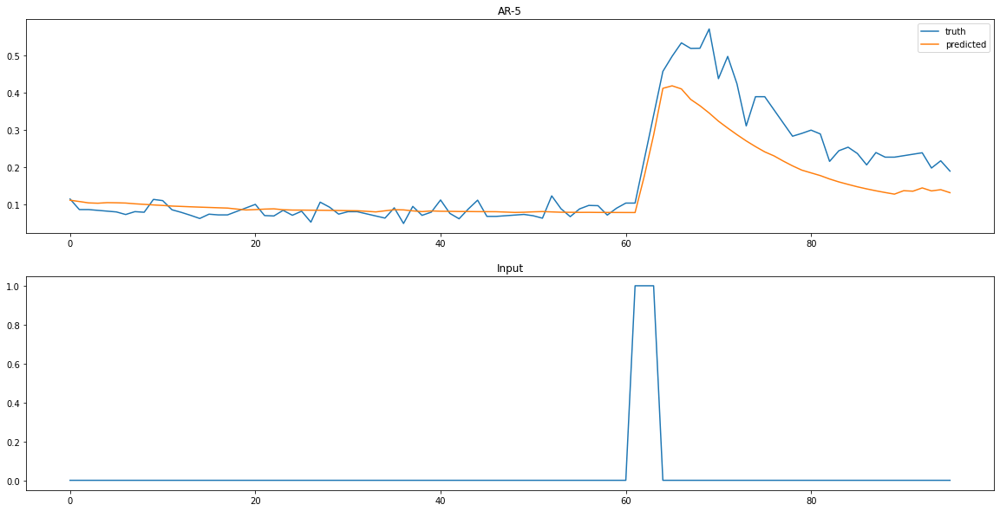

In [37]:
neuron = 53 
idx = 0

plt.figure(figsize=(20,10))
plt.subplot(2,1,1)
plt.plot(x_true[idx][:,neuron],label='truth')
plt.plot(x_pred[idx][:,neuron],label='predicted')
plt.title('AR-5')
plt.legend()

plt.subplot(2,1,2)
plt.plot(u_true[idx][:,neuron],label='input')
plt.title('Input')

Text(0.5, 1.0, 'Input')

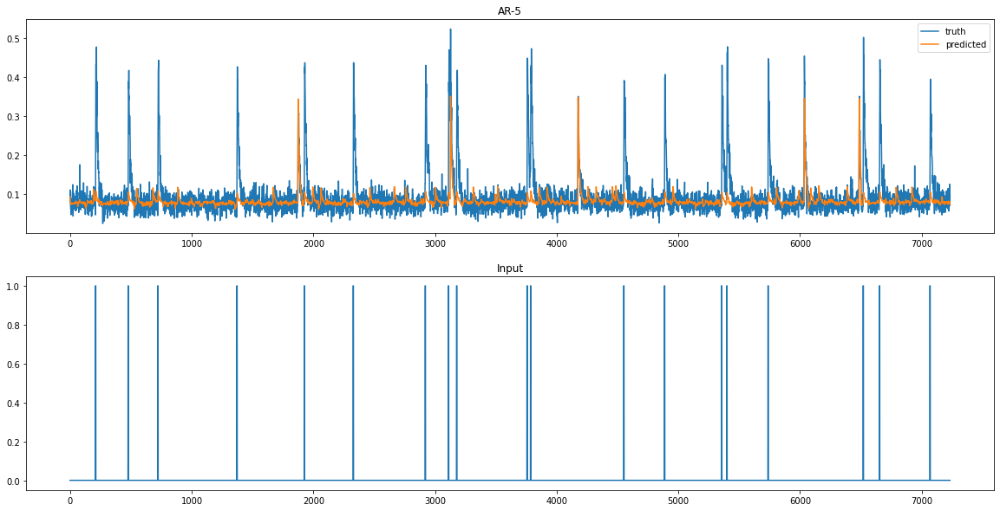

In [76]:
neuron = removed_neurons[6]
length = 10000

output_pred = []
output_true = []
input_true = []
segment_marker = []

for i in range(np.min([len(x_true),length])):
    output_pred.extend(x_pred[i][:,neuron])
    #output_pred.append(np.nan)
    output_true.extend(x_true[i][:,neuron])
    #output_true.append(np.nan)
    input_true.extend(u_true[i][:,neuron])
    #input_true.append(np.nan)
    segment_marker.extend(np.nan*np.zeros(len(x_pred[i][:,neuron])-1))
    segment_marker.extend([0.25,0])
    
plt.figure(figsize=(20,10))
plt.subplot(2,1,1)
plt.plot(output_true,label='truth')
plt.plot(output_pred,label='predicted')
#plt.plot(segment_marker)
plt.title('AR-5')
plt.legend()

plt.subplot(2,1,2)
plt.plot(input_true,label='input')
plt.title('Input')

# Evaluate Fit

In [78]:
tpr = []
fpr = []
thresholds = np.linspace(-2,5,15)

for thresholds_idx in range(len(thresholds)):
    tp_total = 0
    fp_total = 0
    p_total = 0
    n_total = 0

    for neuron in range(u_session.shape[1]):
        output_pred = []
        output_true = []
        for i in range(len(x_true)):
            output_pred.extend(x_pred[i][:,neuron])
            output_true.extend(x_true[i][:,neuron])
        output_pred = np.array(output_pred)
        output_true = np.array(output_true)
    
        mean_threshold = np.median(output_true)
        lower_tail_idx = (output_true < mean_threshold)
        lower_tail_data = output_true[lower_tail_idx]
        lower_tail_std = np.std(lower_tail_data)
        true_spike_threshold = mean_threshold + 6*lower_tail_std
        detect_spike_threshold = mean_threshold + thresholds[thresholds_idx]*lower_tail_std

        predicted_spikes = (output_pred > detect_spike_threshold)
        true_spikes = (output_true > true_spike_threshold)
        tp_total += np.sum(np.logical_and(predicted_spikes,true_spikes))
        fp_total += np.sum(np.logical_and(predicted_spikes,~true_spikes))
        p_total += np.sum(true_spikes)
        n_total += np.sum(~true_spikes)

    tpr.append(tp_total / p_total)
    fpr.append(fp_total / n_total)

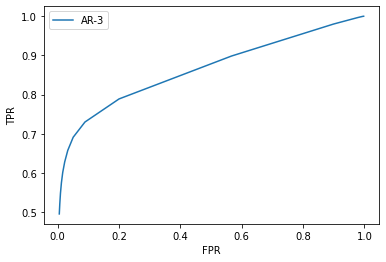

In [79]:
plt.plot(fpr,tpr,label='AR-3')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()
#plt.xlim([-0.1,0.2])
#plt.ylim([-0.1,1.1])

In [80]:
tpr_noninput = []
fpr_noninput = []
thresholds = np.linspace(-2,5,15)

for thresholds_idx in range(len(thresholds)):
    tp_total = 0
    fp_total = 0
    p_total = 0
    n_total = 0

    for neuron in range(u_session.shape[1]):
        output_pred = []
        output_true = []
        for i in range(len(x_true)):
            if np.sum(u_true[i][:,neuron]) == 0:
                output_pred.extend(x_pred[i][:,neuron])
                output_true.extend(x_true[i][:,neuron])
        output_pred = np.array(output_pred)
        output_true = np.array(output_true)
    
        mean_threshold = np.median(output_true)
        lower_tail_idx = (output_true < mean_threshold)
        lower_tail_data = output_true[lower_tail_idx]
        lower_tail_std = np.std(lower_tail_data)
        true_spike_threshold = mean_threshold + 6*lower_tail_std
        detect_spike_threshold = mean_threshold + thresholds[thresholds_idx]*lower_tail_std

        predicted_spikes = (output_pred > detect_spike_threshold)
        true_spikes = (output_true > true_spike_threshold)
        tp_total += np.sum(np.logical_and(predicted_spikes,true_spikes))
        fp_total += np.sum(np.logical_and(predicted_spikes,~true_spikes))
        p_total += np.sum(true_spikes)
        n_total += np.sum(~true_spikes)

    tpr_noninput.append(tp_total / p_total)
    fpr_noninput.append(fp_total / n_total)

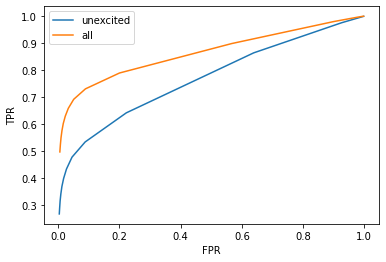

In [82]:
plt.plot(fpr_noninput,tpr_noninput,label='unexcited')
plt.plot(fpr,tpr,label='all')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()
#plt.xlim([-0.1,0.2])
#plt.ylim([-0.1,1.1])

# Evaluation Functions

In [32]:
def compute_gt_test_segments(y_session,true_spikes,prediction,test_indices,start_idx):
    x_true = []
    u_true = []
    labels = []
    pred_new = []
    input_segment = []
    idx = -1

    new_segment = True
    segment_pred = []
    segment_start = -1
    for t in range(test_indices.shape[0]):
        if test_indices[t] == 1:
            if new_segment:
                pred_idx = 0
                new_segment = False
                segment_start = t
                x_past = []
                x_true.append([])
                u_true.append([])
                labels.append([])
                pred_new.append([])
                input_segment.append(0)
                idx += 1
            if t >= segment_start + start_idx:
                if not np.isnan(y_session[t,0]):
                    x_true[idx].append(y_session[t,:].copy().flatten() / 1000)
                    u_true[idx].append(u_session[t,:].copy().flatten())
                    labels[idx].append(true_spikes[t,:].copy().flatten())
                    pred_new[idx].append(prediction[idx][pred_idx,:].copy().flatten())
                pred_idx += 1
            input_segment[idx] = np.sum(u_session[segment_start:segment_start+t+1,:], axis=0) > 0
        else:
            new_segment = True

    for i in range(len(x_true)):
        x_true[i] = np.array(x_true[i])
        u_true[i] = np.array(u_true[i])
        labels[i] = np.array(labels[i]).astype(bool)
        pred_new[i] = np.array(pred_new[i])
        
    return x_true, u_true, labels, pred_new, input_segment

In [60]:
def compute_roc(prediction,start_idx,thresholds=np.linspace(-2,5,15),train_indices=None,test_indices=None):
    '''
    Inputs:
    prediction - Assume there are n distinct test segments, and segment i has length m_i. Then prediction should
    be a list of length n, where element i in the list is the predictions on the indices at test segment i.
    We assume the model may use the first start_idx samples from each test segment to initialize the model, 
    so prediction[i] should be an numpy array of size (m_i - start_idx, 663). 
    
    start_idx - see above.
    
    thresholds - array true/false spike thresholds to classify predictions as spikes.
    
    Outputs: 
    tpr - array of length len(thresholds) of true positive rate for all predictions
    fpr - array of length len(thresholds) of false positive rate for all predictions
    tpr_noinput - array of length len(thresholds) of true positive rate for predictions on neurons where input
                    not applied.
    fpr_noinput - array of length len(thresholds) of false positive rate for predictions on neurons where input
                    not applied.
    '''
    data = np.load('sample_photostim_0113.npy', allow_pickle = True).item()
    y_session = data['y_session']
    u_session = data['u_session']
    if train_indices is None:
        split = np.load('../train_test_split.npy', allow_pickle=True).item()
        train_indices = split['train_indices']
        test_indices = split['test_indices']
    true_spikes = np.load('../spiking_labels.npy')
    x_true, u_true, true_spikes, prediction, input_segment = compute_gt_test_segments(y_session,true_spikes,prediction,test_indices,start_idx)
    
    tpr = []
    fpr = []
    tpr_noinput = []
    fpr_noinput = []

    for thresholds_idx in range(len(thresholds)):
        for mode_idx in range(2):
            tp_total = 0
            fp_total = 0
            p_total = 0
            n_total = 0

            for neuron in range(u_session.shape[1]):
                output_pred = []
                output_true = []
                output_label = []
                sequence_idx = 0
                for i in range(len(x_true)):
                    if mode_idx == 0:
                        output_pred.extend(prediction[i][:,neuron])
                        output_true.extend(x_true[i][:,neuron])
                        output_label.extend(true_spikes[i][:,neuron])
                    elif not input_segment[i][neuron]:
                        output_pred.extend(prediction[i][:,neuron])
                        output_true.extend(x_true[i][:,neuron])
                        output_label.extend(true_spikes[i][:,neuron])
                output_pred = np.array(output_pred)
                output_true = np.array(output_true)
                output_label = np.array(output_label).astype(bool)

                mean_threshold = np.median(output_true)
                lower_tail_idx = (output_true < mean_threshold)
                lower_tail_data = output_true[lower_tail_idx]
                lower_tail_std = np.std(lower_tail_data)
                detect_spike_threshold = mean_threshold + thresholds[thresholds_idx]*lower_tail_std

                predicted_spikes = (output_pred > detect_spike_threshold)
                tp_total += np.sum(np.logical_and(predicted_spikes,output_label))
                fp_total += np.sum(np.logical_and(predicted_spikes,~output_label))
                p_total += np.sum(output_label)
                n_total += np.sum(~output_label)

            if mode_idx == 0:
                tpr.append(tp_total / p_total)
                fpr.append(fp_total / n_total)
            else:
                if p_total > 0:
                    tpr_noinput.append(tp_total / p_total)
                if n_total > 0:
                    fpr_noinput.append(fp_total / n_total)
    return tpr, fpr, tpr_noinput, fpr_noinput

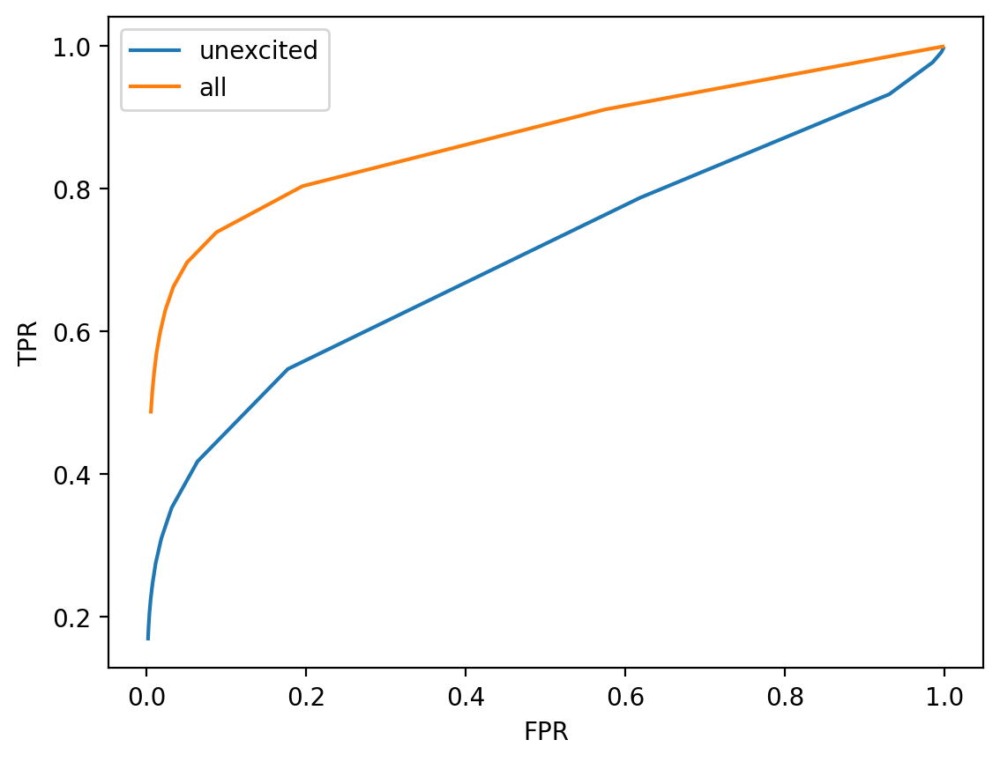

In [74]:
tpr, fpr, tpr_noinput, fpr_noinput = compute_roc(x_pred,ark_order)

plt.plot(fpr_noinput,tpr_noinput,label='unexcited')
plt.plot(fpr,tpr,label='all')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()

# Analyze performance

In [43]:
split = np.load('../train_test_split.npy', allow_pickle=True).item()
train_indices = split['train_indices']
test_indices = split['test_indices']

test_indices2 = np.zeros(len(test_indices)).astype(int)
for t in range(train_indices.shape[0]):
    if test_indices[t] == 1:
        if new_segment:
            new_segment = False
            test_indices2[t+15:t+25] = 1
    else:
        new_segment = True


num_train = np.sum(train_indices)
train_indices_seq = np.zeros(len(train_indices))
train_indices_seq[0:num_train] = 1
test_indices_seq = np.zeros(len(test_indices))
test_indices_seq[num_train:] = 1

In [61]:
ark_order = 5
X = []
Xp = []
for t in range(train_indices.shape[0]-ark_order):
    if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        X.append(np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
        Xp.append(y_session_interp[t+ark_order,:].copy().flatten() / 1000)
X = np.array(X)
Xp = np.array(Xp)
Ahat = np.linalg.pinv(X.T @ X) @ X.T @ Xp
Ahat = Ahat.T
#np.save('ARk5_gt', Ahat)

In [37]:
ark_order = 5
X = []
Xp = []
for t in range(train_indices_seq.shape[0]-ark_order):
    if np.sum(train_indices_seq[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        X.append(np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
        Xp.append(y_session_interp[t+ark_order,:].copy().flatten() / 1000)
X = np.array(X)
Xp = np.array(Xp)
Ahat_seq = np.linalg.pinv(X.T @ X) @ X.T @ Xp
Ahat_seq = Ahat_seq.T
#np.save('ARk5_gt', Ahat)

In [69]:
x_pred = []
x_true = []
u_true = []
idx = -1

new_segment = True
segment_pred = []
segment_start = -1
for t in range(train_indices.shape[0]):
    if test_indices[t] == 1:
        if new_segment:
            segment_pred = []
            new_segment = False
            segment_start = t
            x_past = []
            x_pred.append([])
            x_true.append([])
            u_true.append([])
            idx += 1
        if t < segment_start + ark_order:
            x_past.append(y_session_interp[t,:].copy().flatten() / 1000)
        else:
            z = np.array(x_past).flatten()
            z = np.concatenate((z,u_session[t-ark_order:t,:].copy().flatten(),np.ones(1)))
            x_next = Ahat @ z
            x_past.pop(0)
            x_past.append(x_next.copy())
            x_pred[idx].append(x_next.copy())
            x_true[idx].append(y_session_interp[t,:].copy().flatten() / 1000)
            u_true[idx].append(u_session[t,:].copy().flatten())
    else:
        new_segment = True

for i in range(len(x_pred)):
    x_pred[i] = np.array(x_pred[i])
    x_true[i] = np.array(x_true[i])
    u_true[i] = np.array(u_true[i])

In [77]:
x_pred2 = []
x_true2 = []
u_true2 = []
idx = -1

new_segment = True
segment_pred = []
segment_start = -1
for t in range(train_indices.shape[0]):
    if test_indices2[t] == 1:
        if new_segment:
            segment_pred = []
            new_segment = False
            segment_start = t
            x_past = []
            x_pred2.append([])
            x_true2.append([])
            u_true2.append([])
            idx += 1
        if t < segment_start + ark_order:
            x_past.append(y_session_interp[t,:].copy().flatten() / 1000)
        else:
            z = np.array(x_past).flatten()
            z = np.concatenate((z,u_session[t-ark_order:t,:].copy().flatten(),np.ones(1)))
            x_next = Ahat @ z
            x_past.pop(0)
            x_past.append(x_next.copy())
            x_pred2[idx].append(x_next.copy())
            x_true2[idx].append(y_session_interp[t,:].copy().flatten() / 1000)
            u_true2[idx].append(u_session[t,:].copy().flatten())
    else:
        new_segment = True

for i in range(len(x_pred2)):
    x_pred2[i] = np.array(x_pred2[i])
    x_true2[i] = np.array(x_true2[i])
    u_true2[i] = np.array(u_true2[i])

In [38]:
x_pred_seq = []
x_true_seq = []
u_true_seq = []
idx = -1

new_segment = True
segment_pred = []
segment_start = -1
for t in range(train_indices.shape[0]):
    if test_indices_seq[t] == 1:
        if new_segment:
            segment_pred = []
            new_segment = False
            segment_start = t
            x_past = []
            x_pred_seq.append([])
            x_true_seq.append([])
            u_true_seq.append([])
            idx += 1
        if t < segment_start + ark_order:
            x_past.append(y_session_interp[t,:].copy().flatten() / 1000)
        else:
            z = np.array(x_past).flatten()
            z = np.concatenate((z,u_session[t-ark_order:t,:].copy().flatten(),np.ones(1)))
            x_next = Ahat_seq @ z
            x_past.pop(0)
            x_past.append(x_next.copy())
            x_pred_seq[idx].append(x_next.copy())
            x_true_seq[idx].append(y_session_interp[t,:].copy().flatten() / 1000)
            u_true_seq[idx].append(u_session[t,:].copy().flatten())
    else:
        new_segment = True

for i in range(len(x_pred_seq)):
    x_pred_seq[i] = np.array(x_pred_seq[i])
    x_true_seq[i] = np.array(x_true_seq[i])
    u_true_seq[i] = np.array(u_true_seq[i])

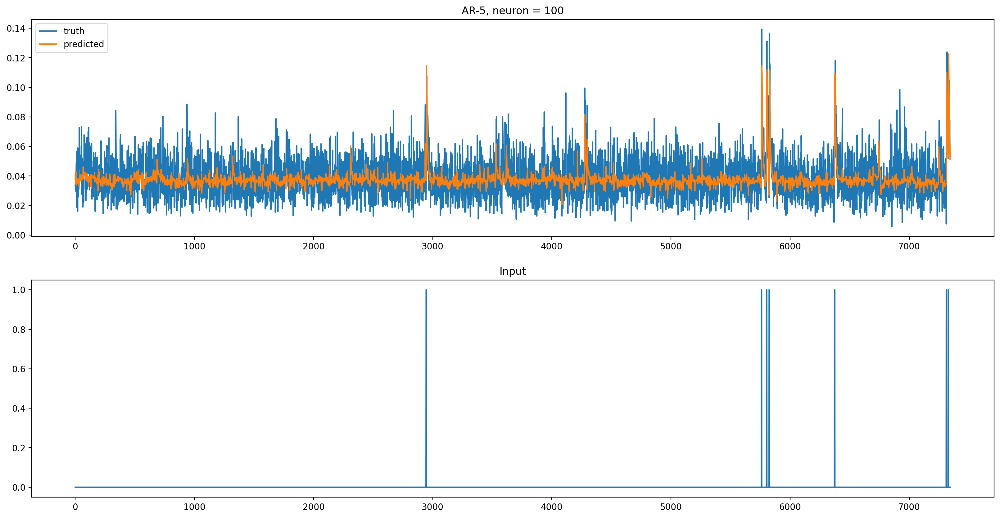

-------------------------------------------------


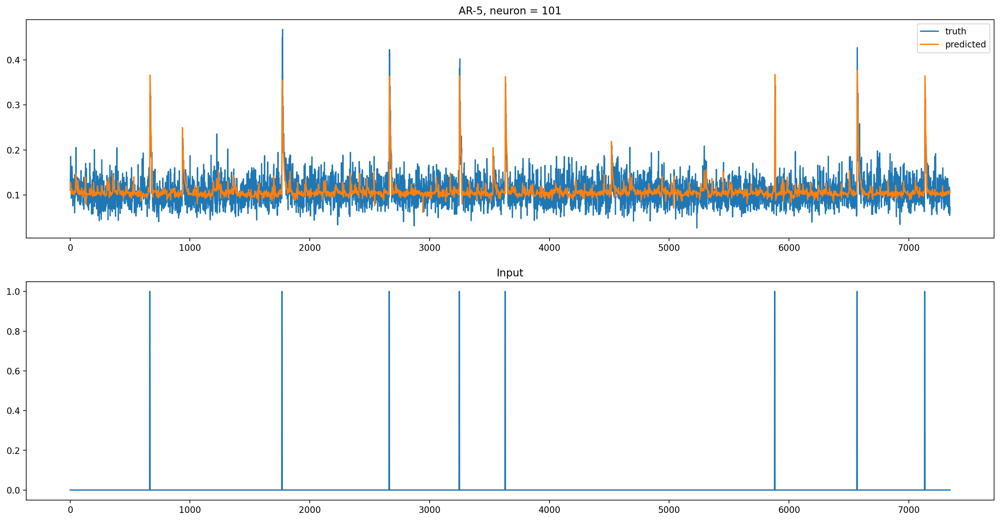

-------------------------------------------------


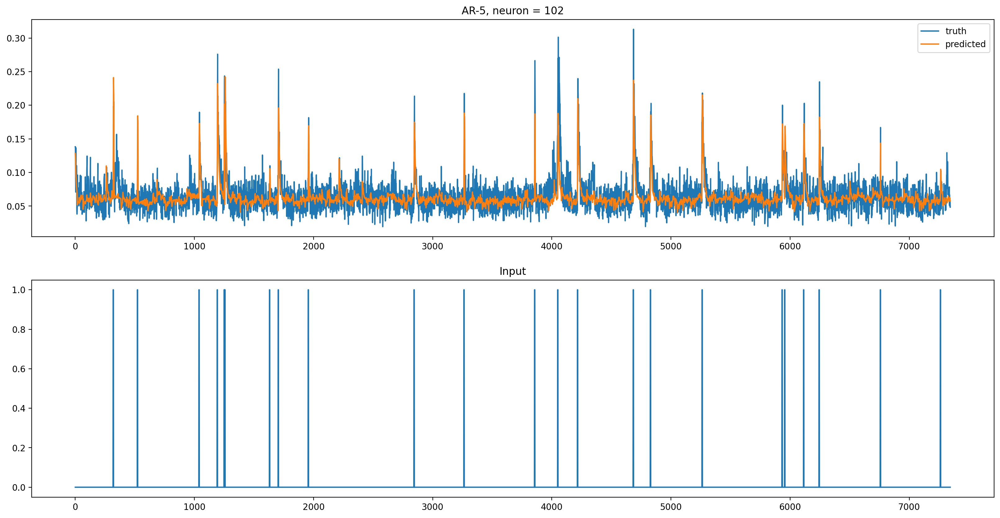

-------------------------------------------------


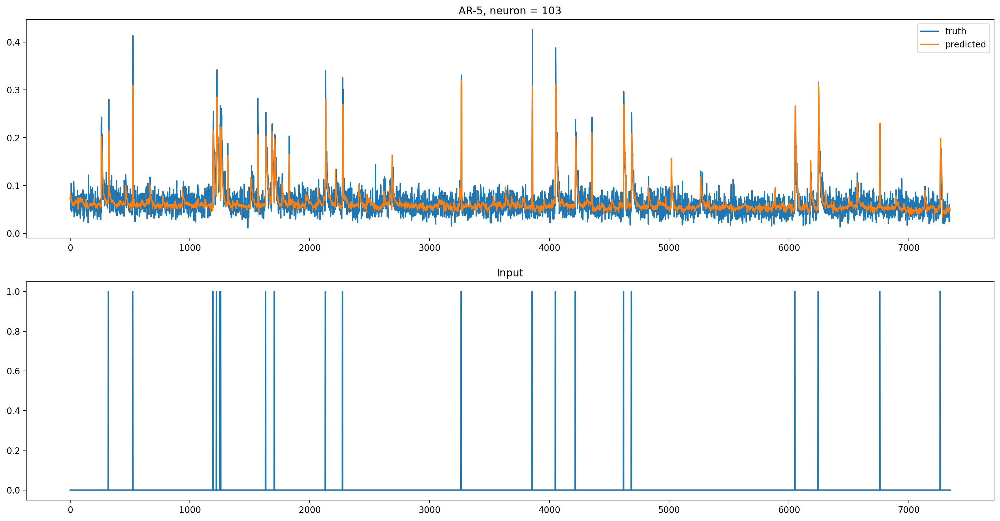

-------------------------------------------------


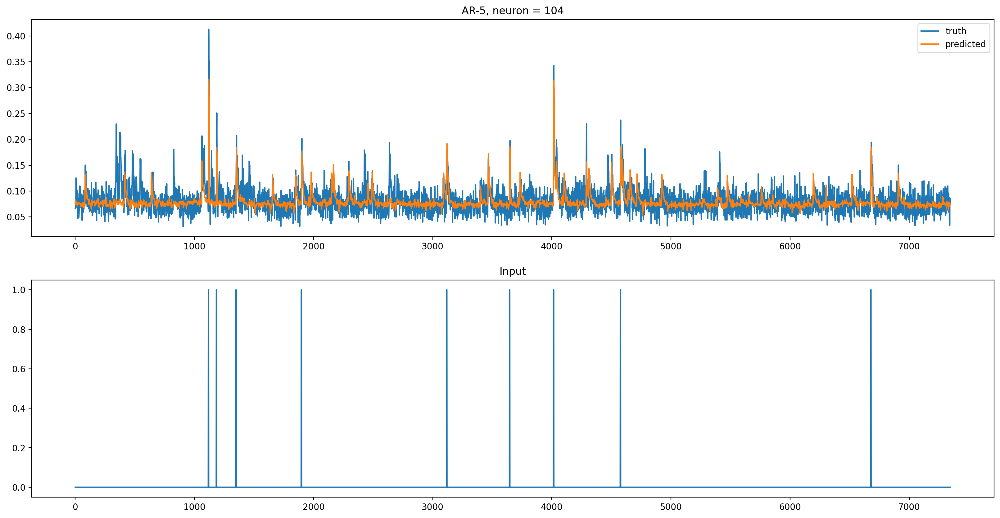

-------------------------------------------------


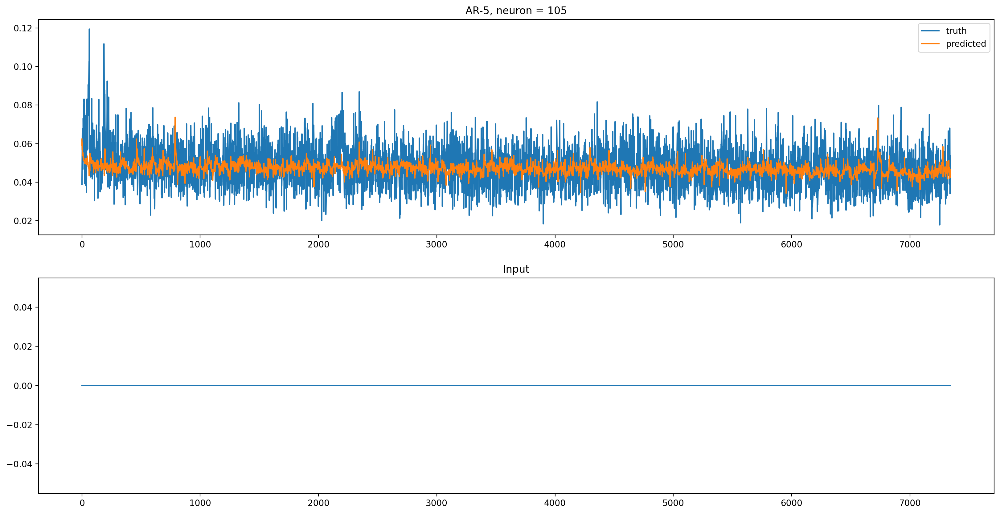

-------------------------------------------------


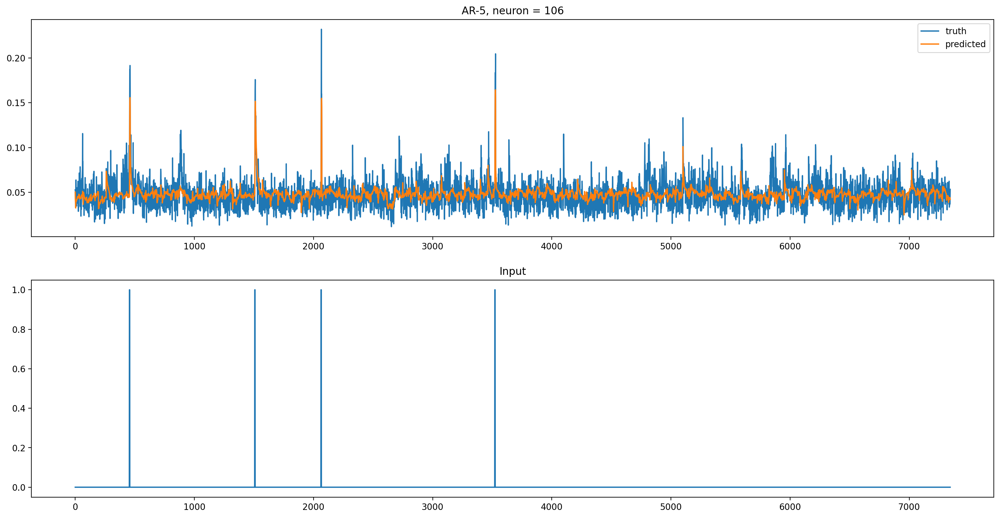

-------------------------------------------------


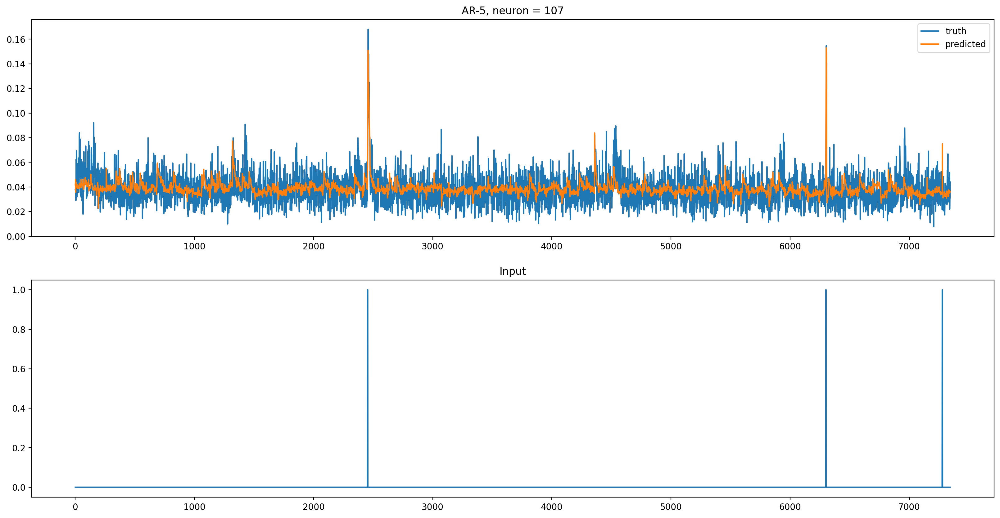

-------------------------------------------------


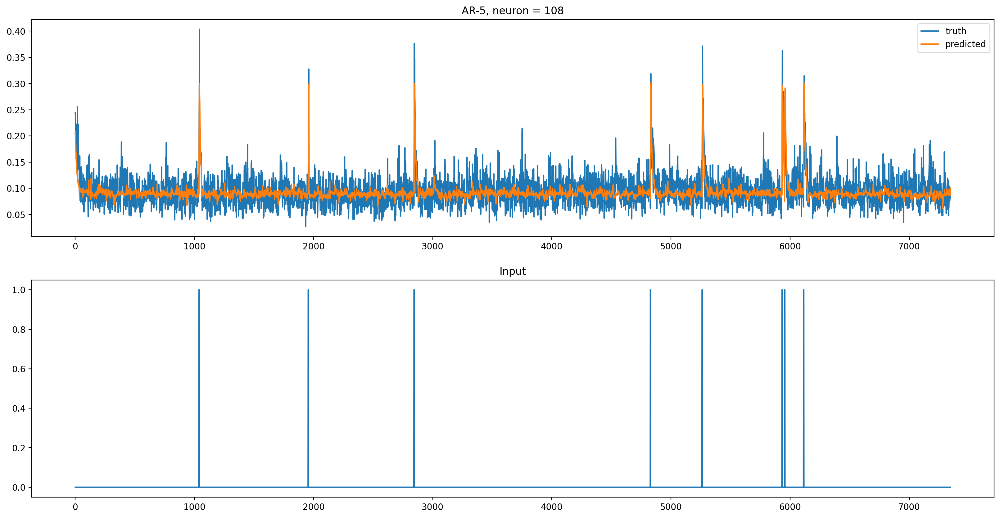

-------------------------------------------------


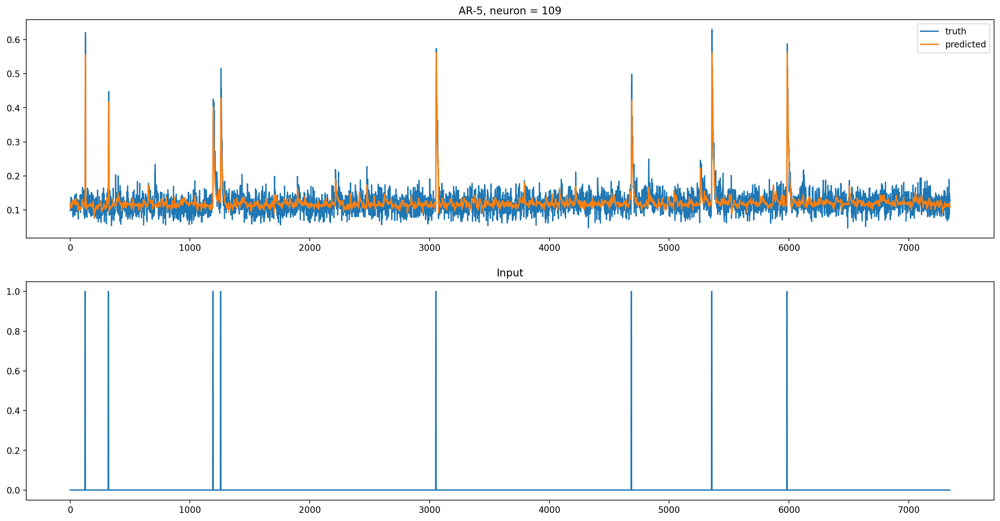

-------------------------------------------------


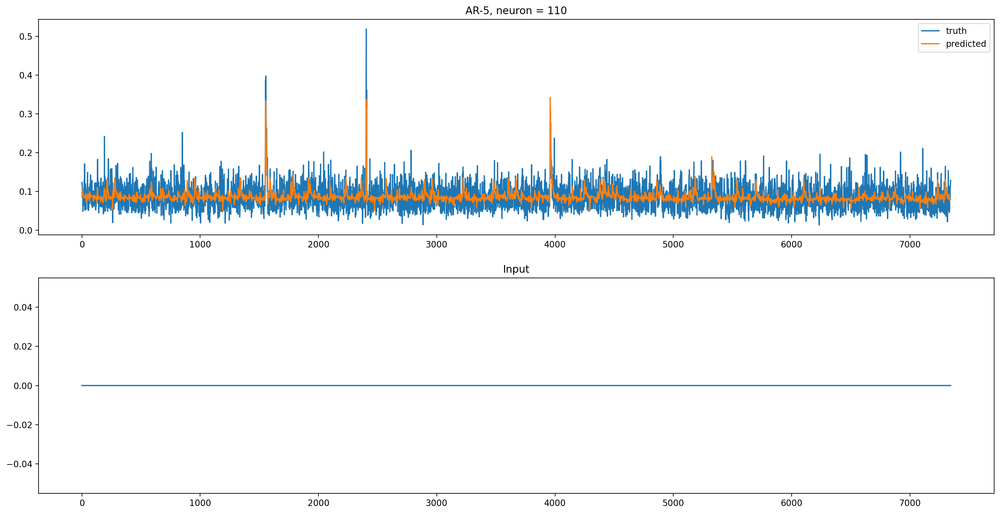

-------------------------------------------------


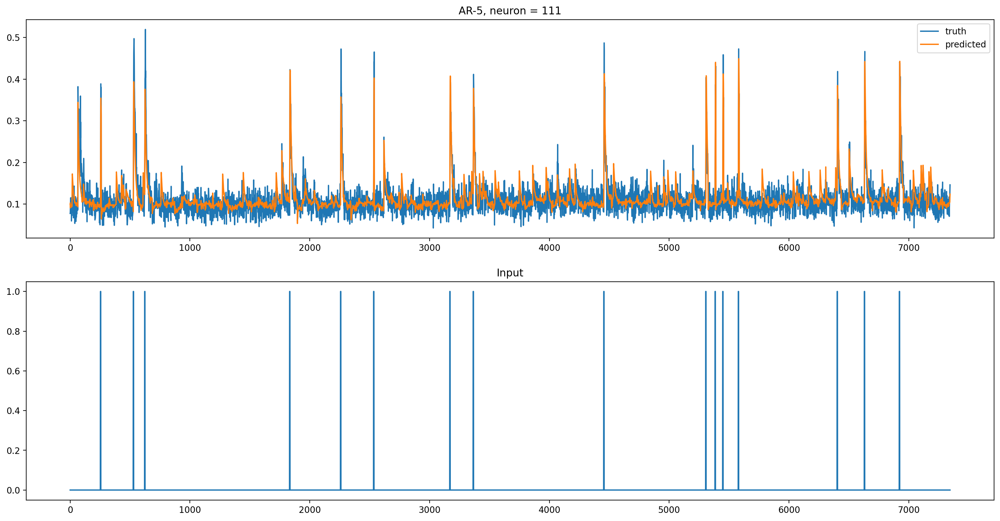

-------------------------------------------------


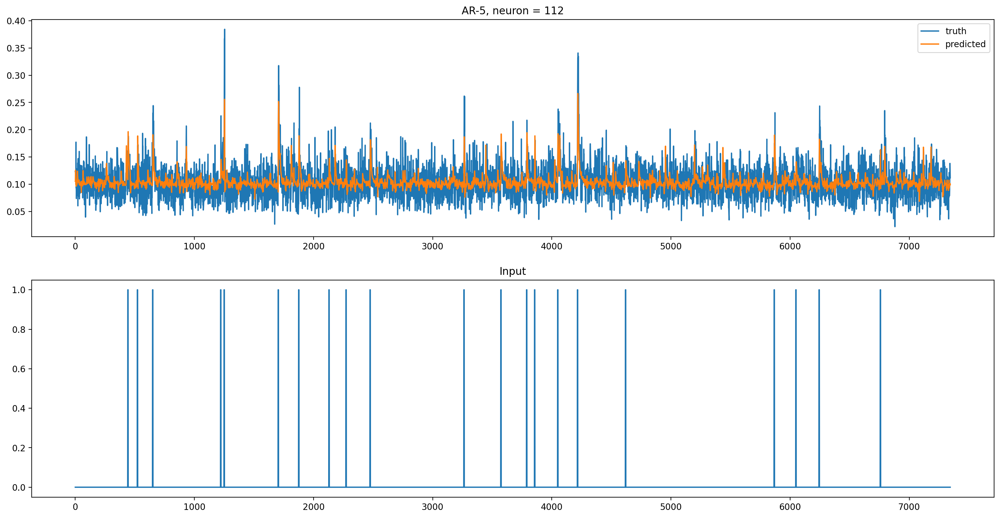

-------------------------------------------------


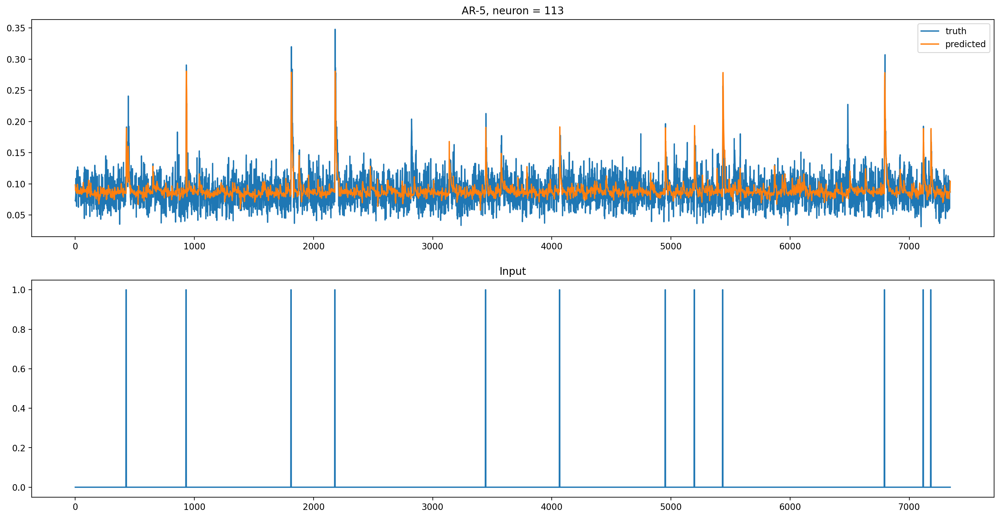

-------------------------------------------------


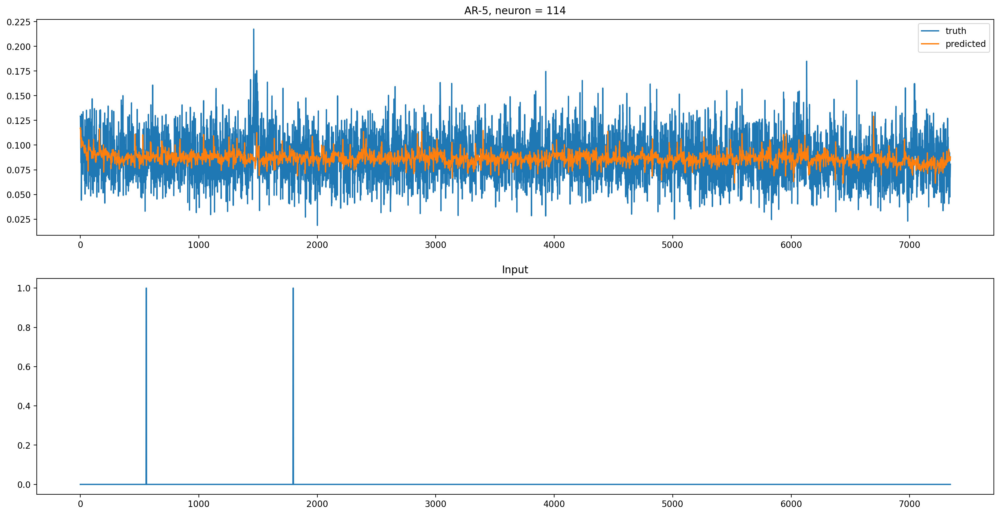

-------------------------------------------------


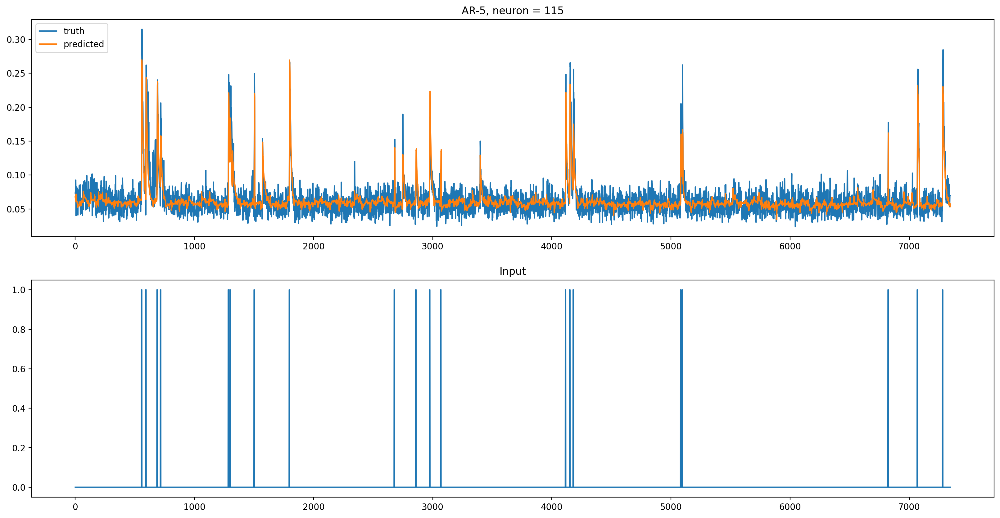

-------------------------------------------------


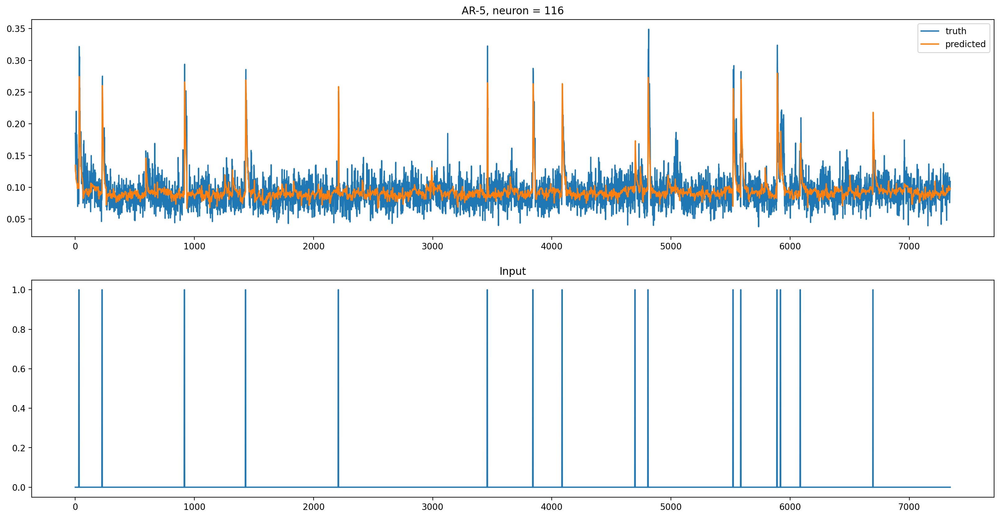

-------------------------------------------------


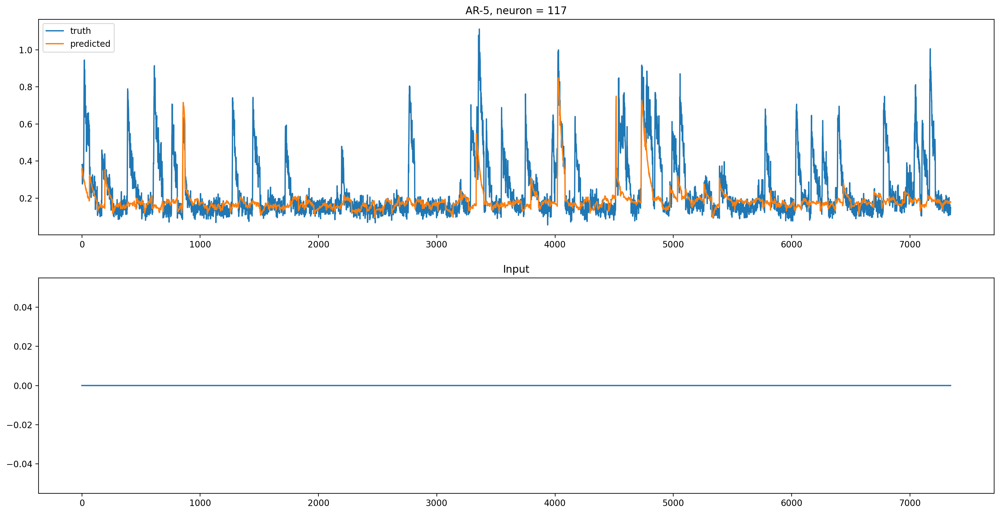

-------------------------------------------------


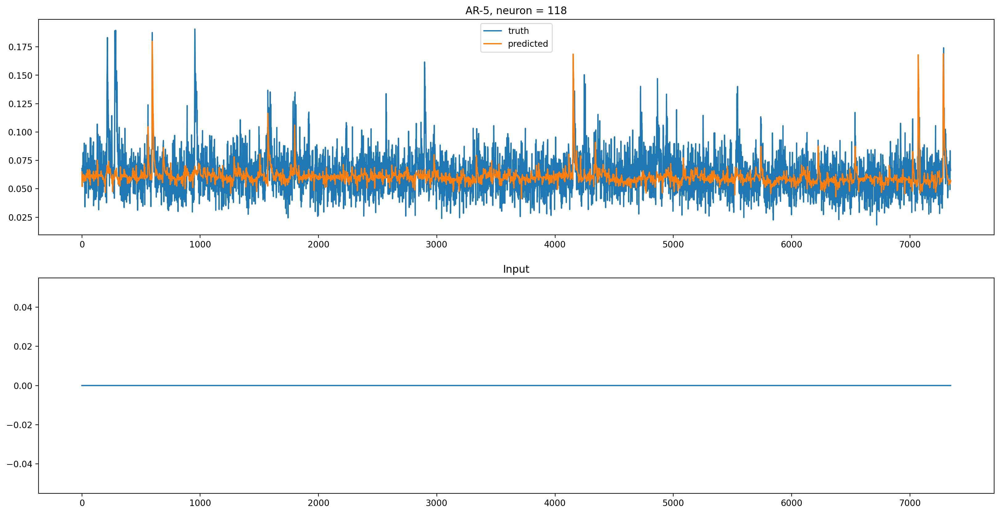

-------------------------------------------------


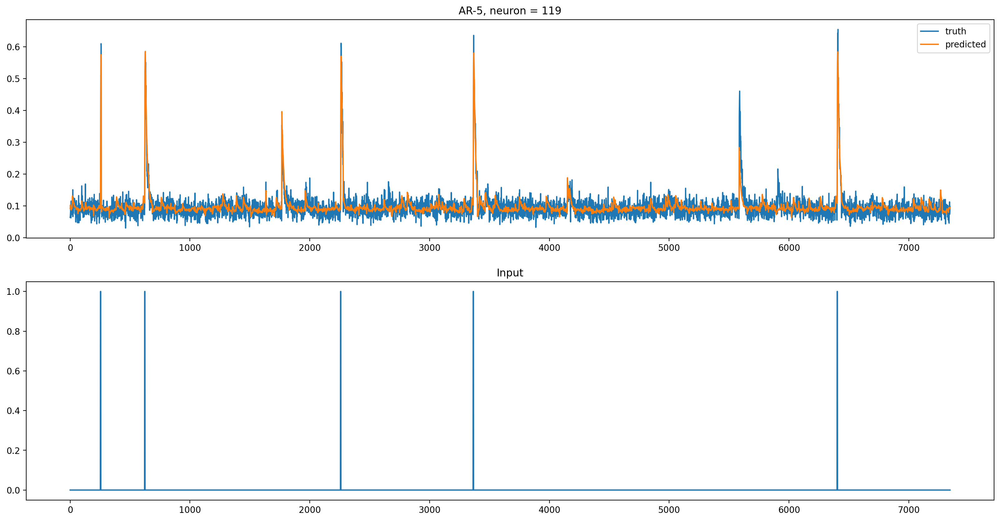

-------------------------------------------------


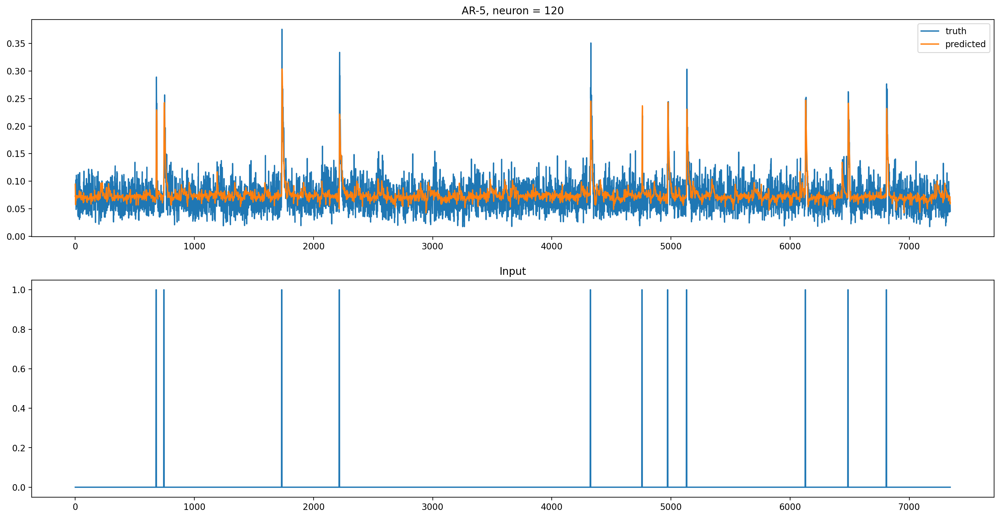

-------------------------------------------------


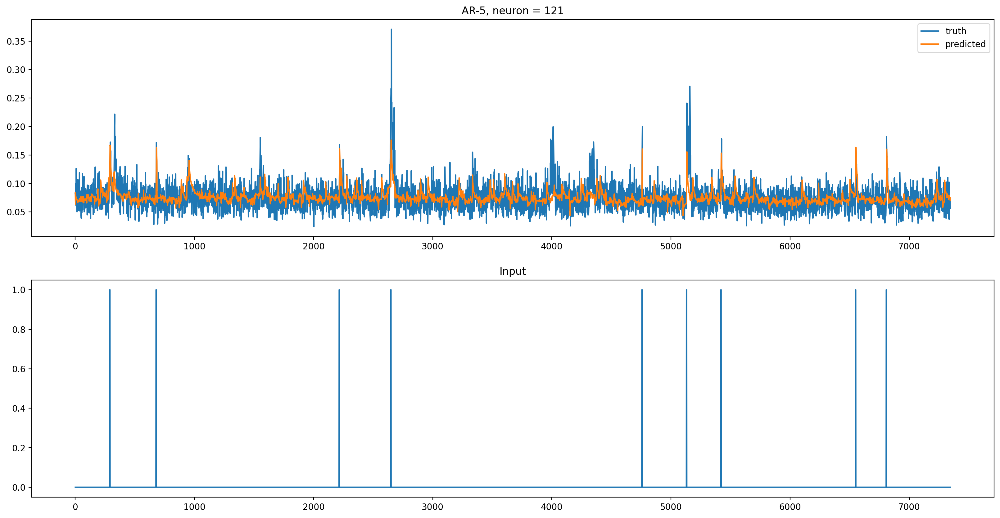

-------------------------------------------------


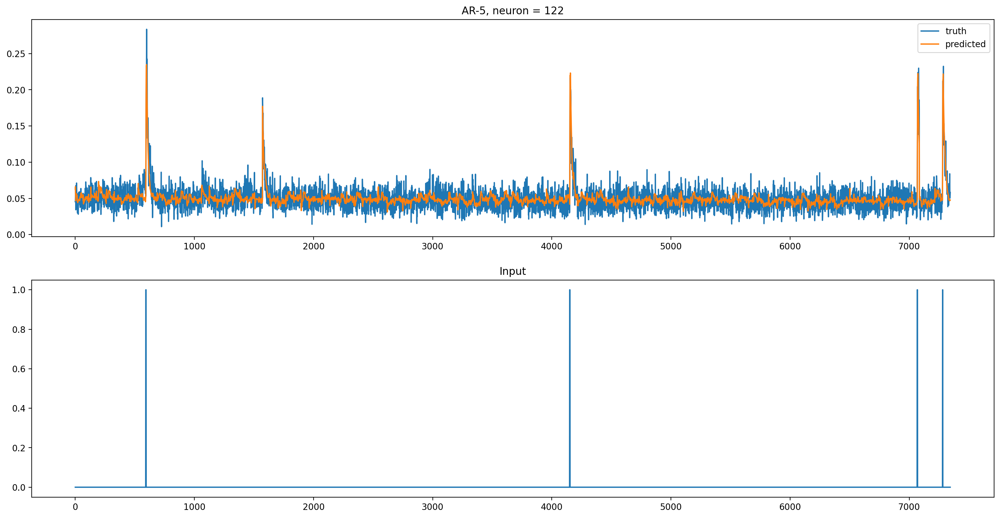

-------------------------------------------------


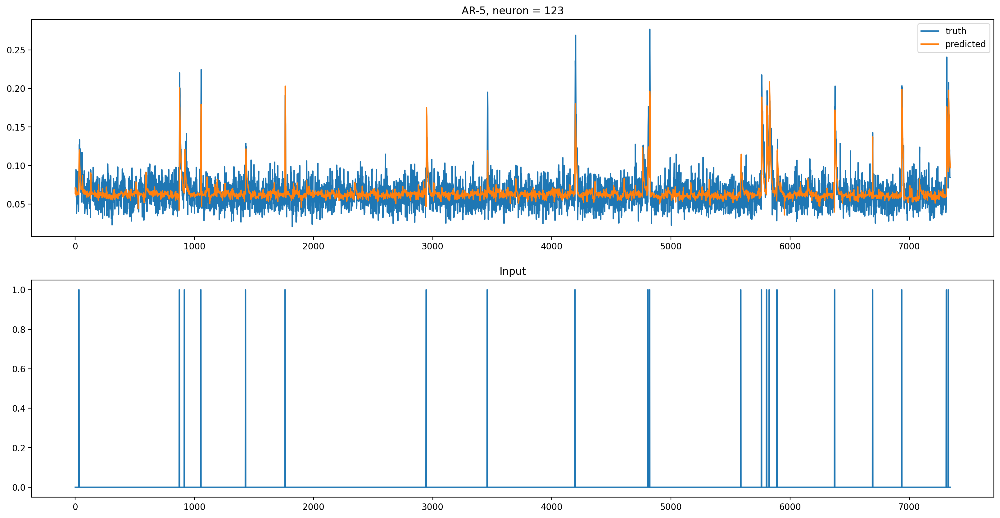

-------------------------------------------------


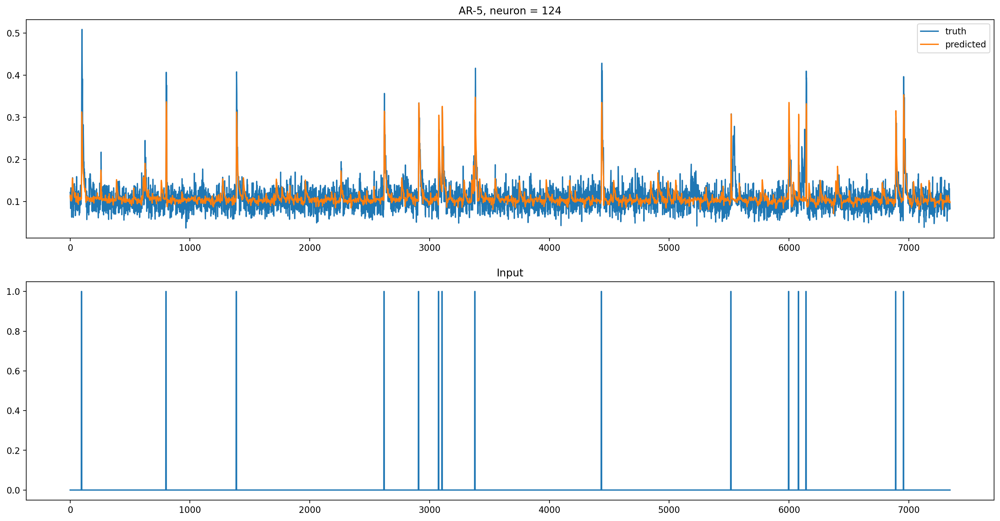

-------------------------------------------------


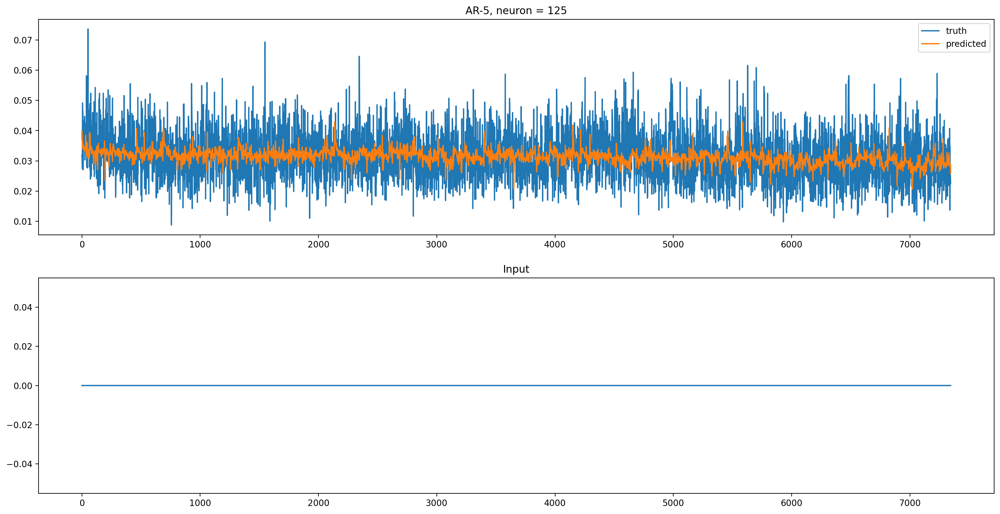

-------------------------------------------------


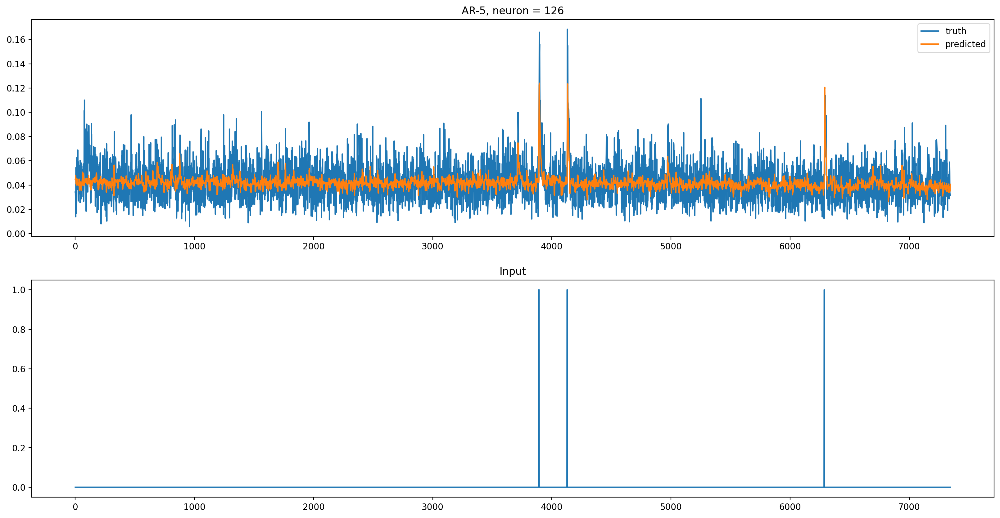

-------------------------------------------------


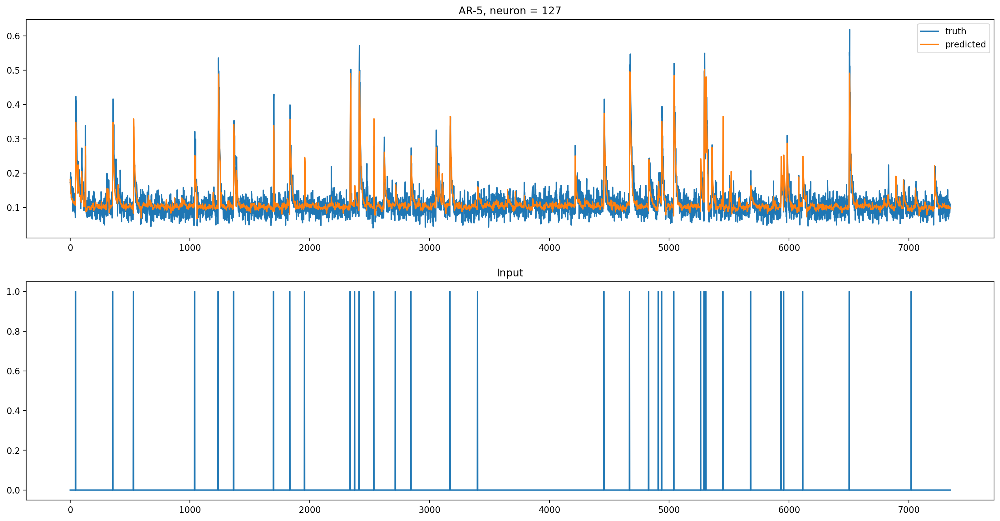

-------------------------------------------------


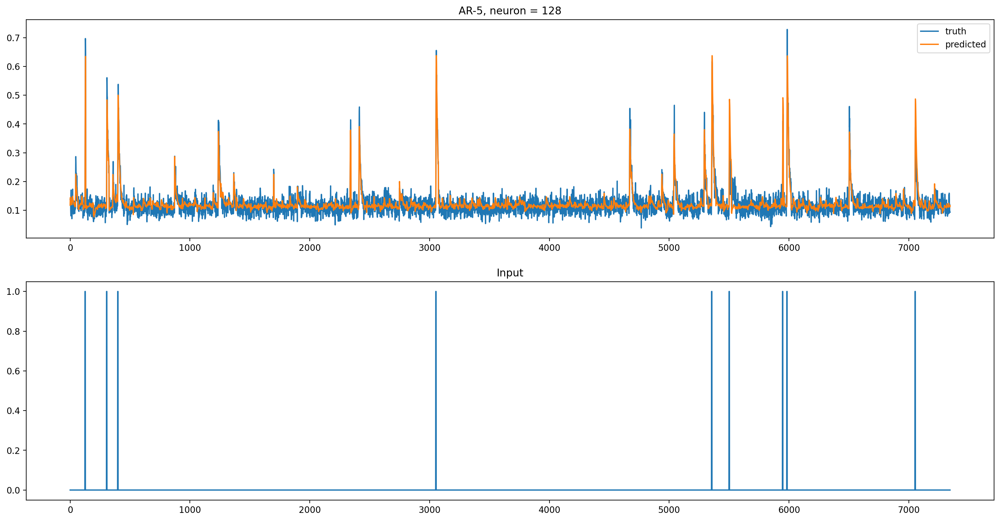

-------------------------------------------------


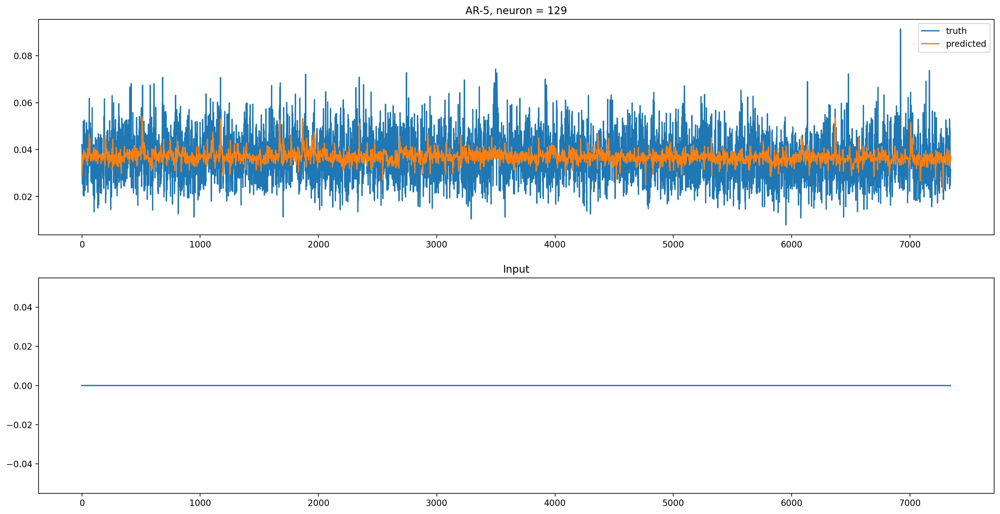

-------------------------------------------------


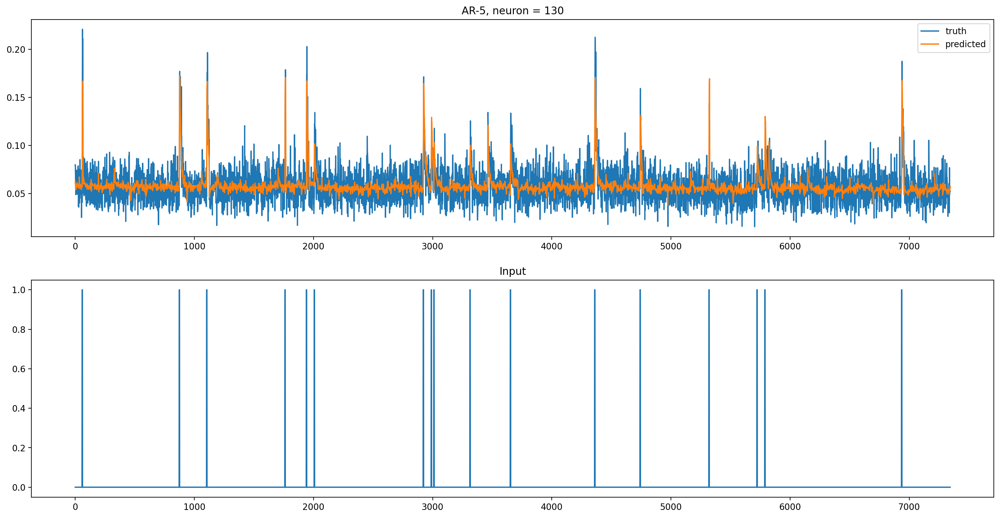

-------------------------------------------------


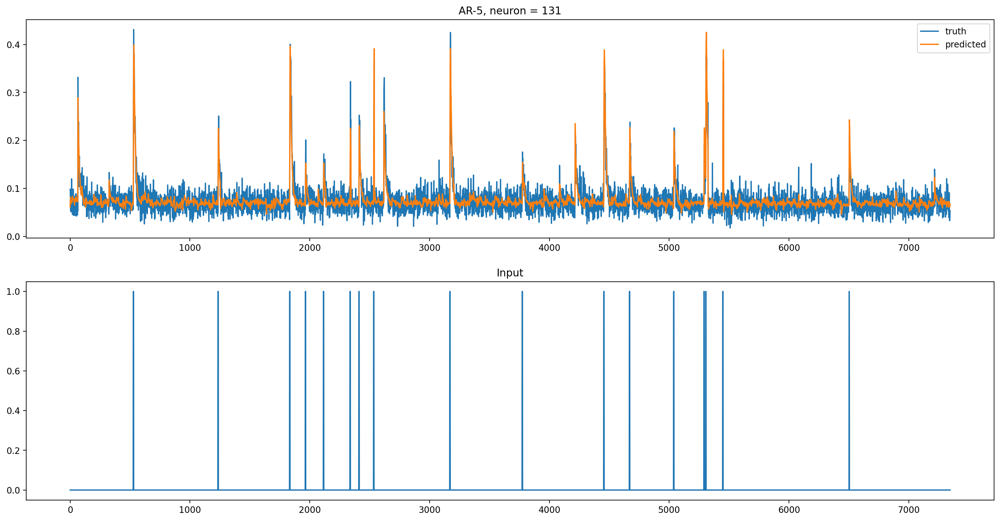

-------------------------------------------------


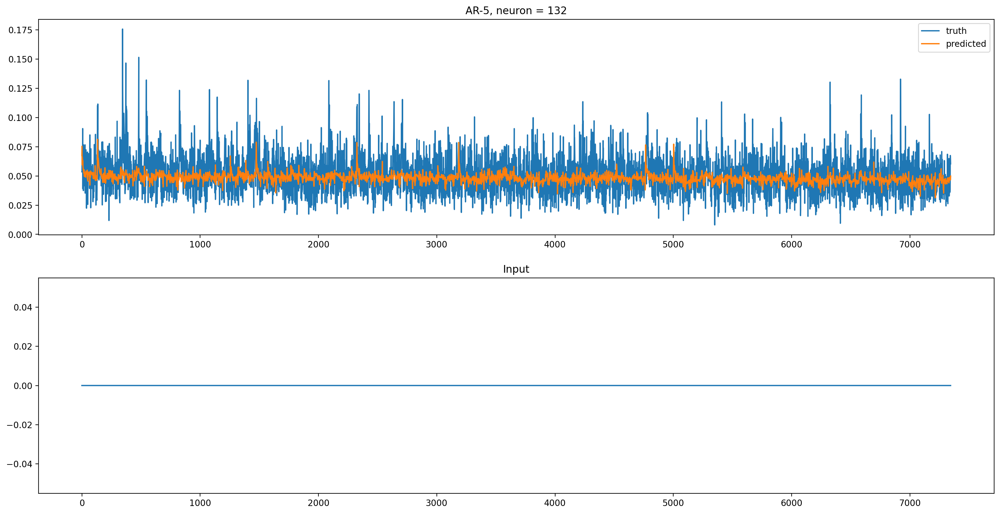

-------------------------------------------------


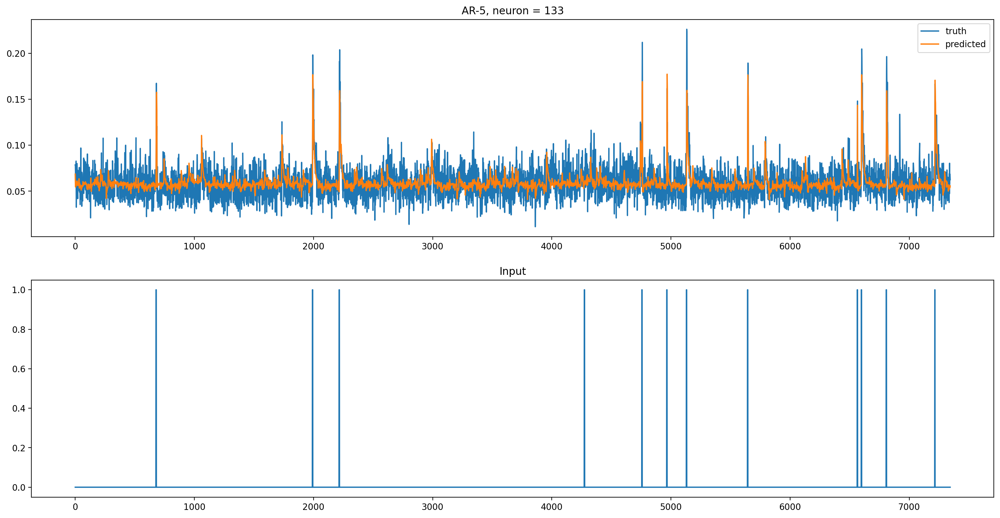

-------------------------------------------------


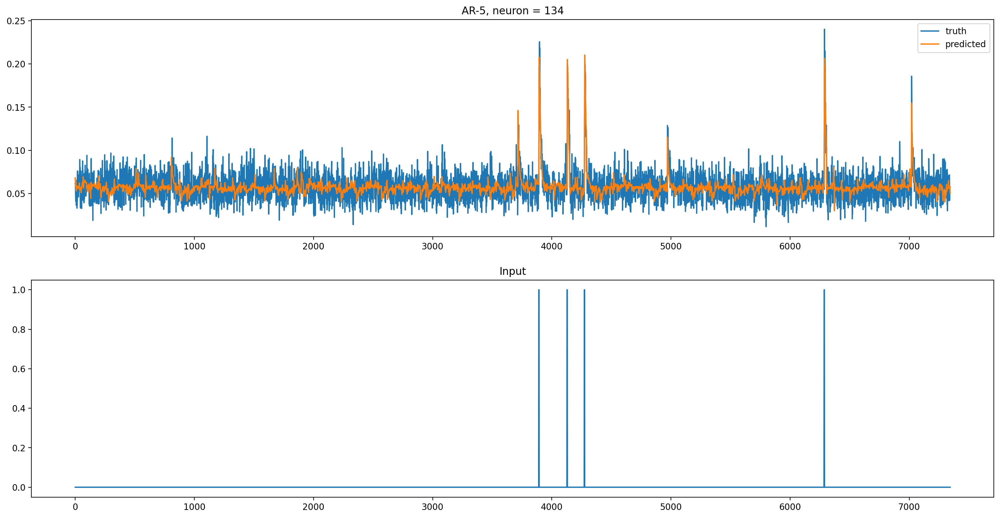

-------------------------------------------------


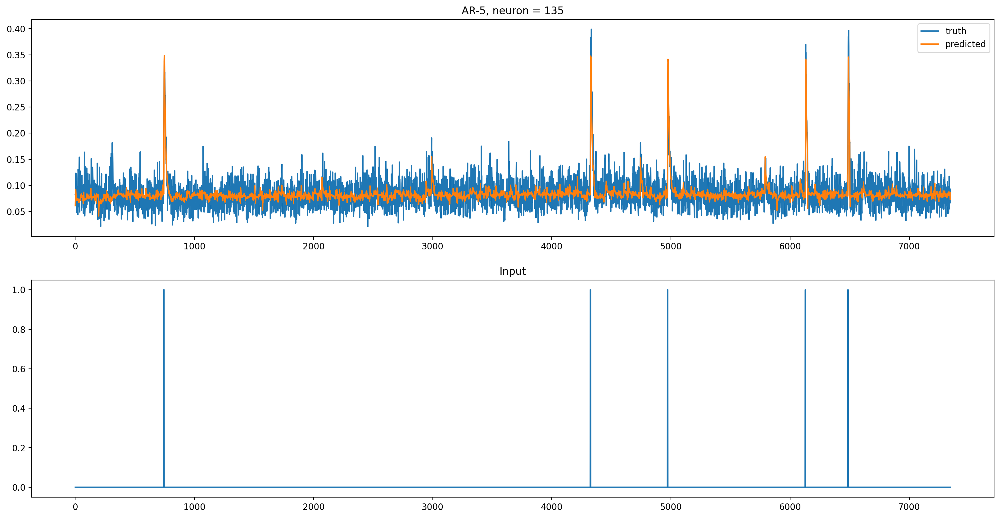

-------------------------------------------------


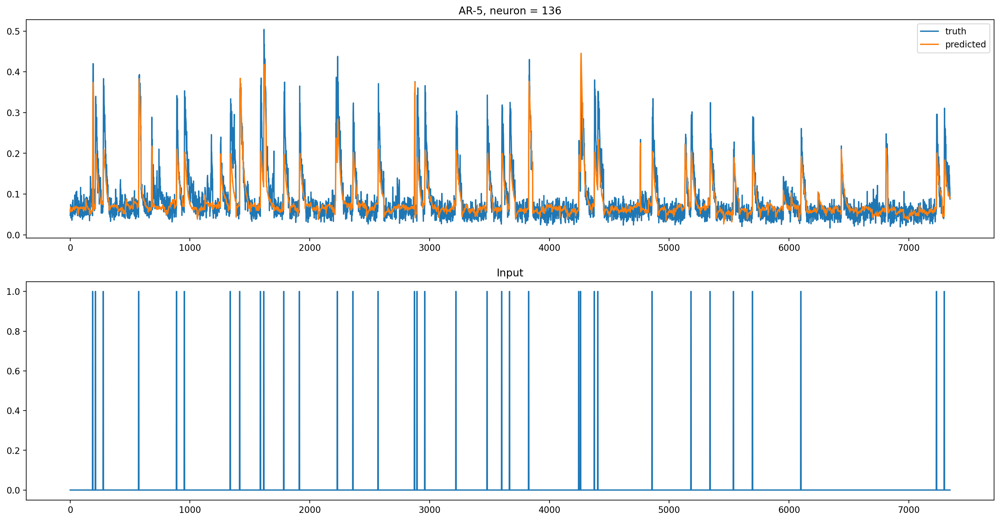

-------------------------------------------------


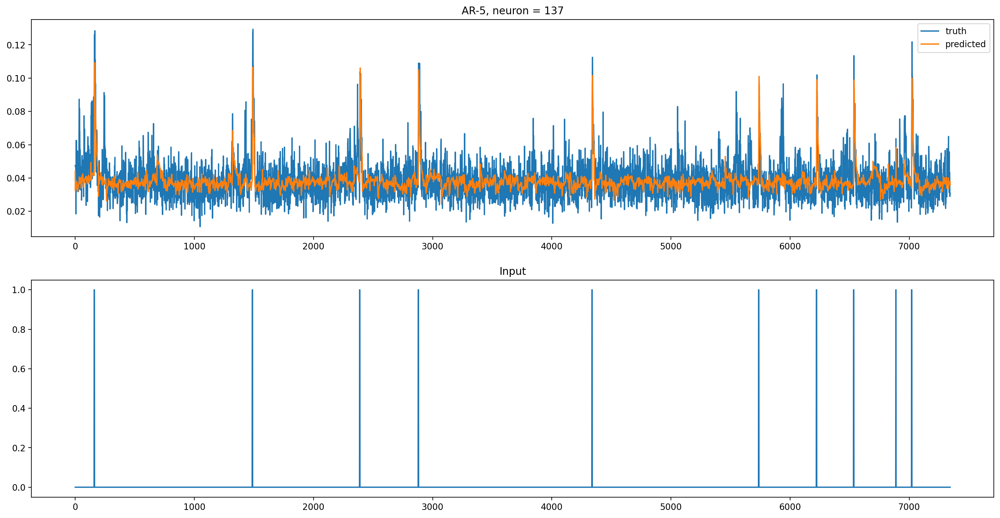

-------------------------------------------------


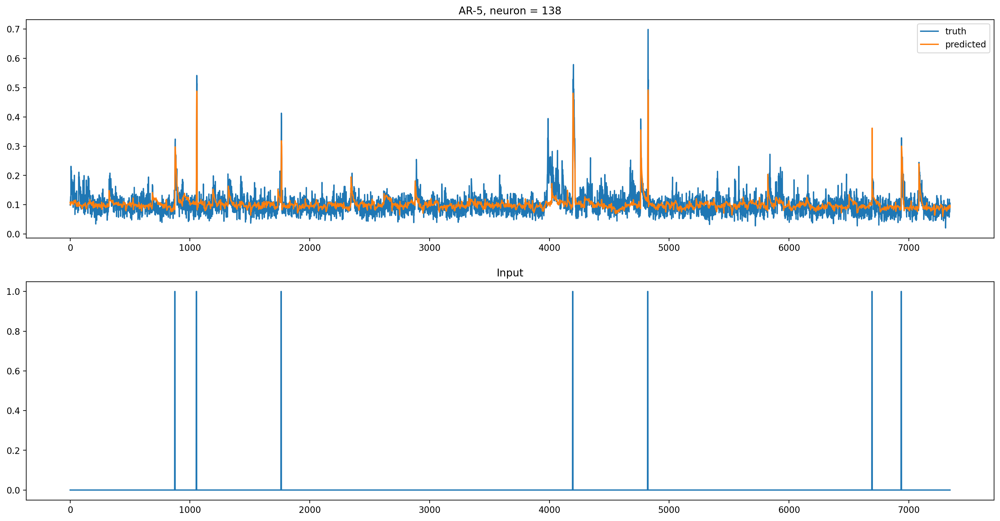

-------------------------------------------------


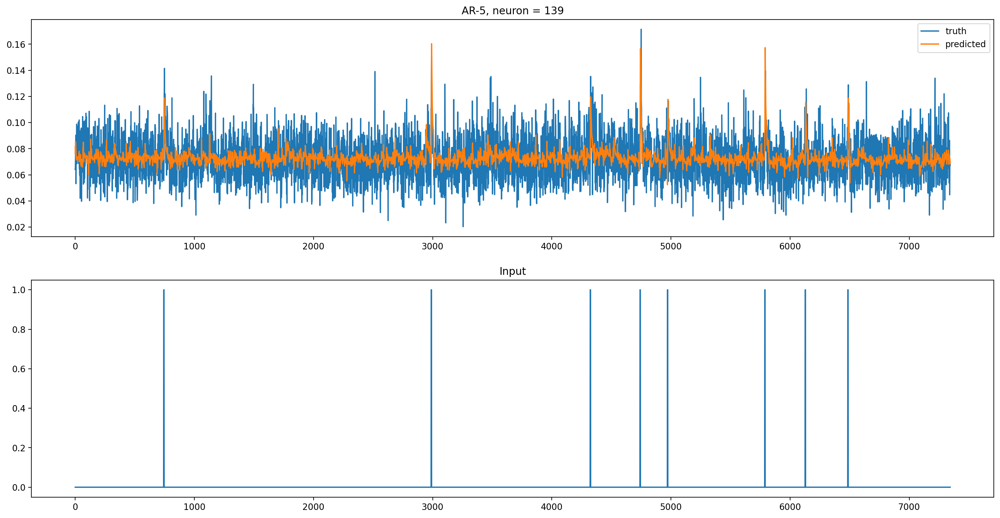

-------------------------------------------------


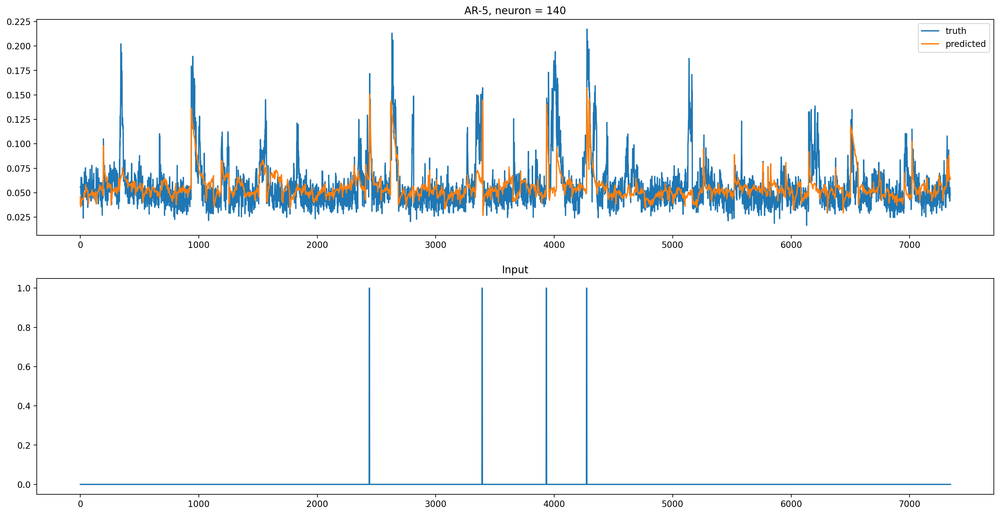

-------------------------------------------------


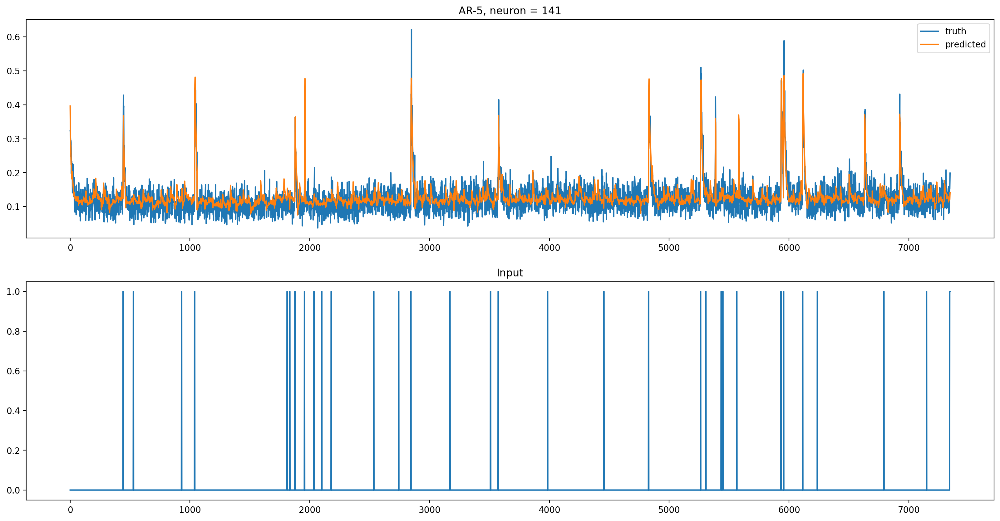

-------------------------------------------------


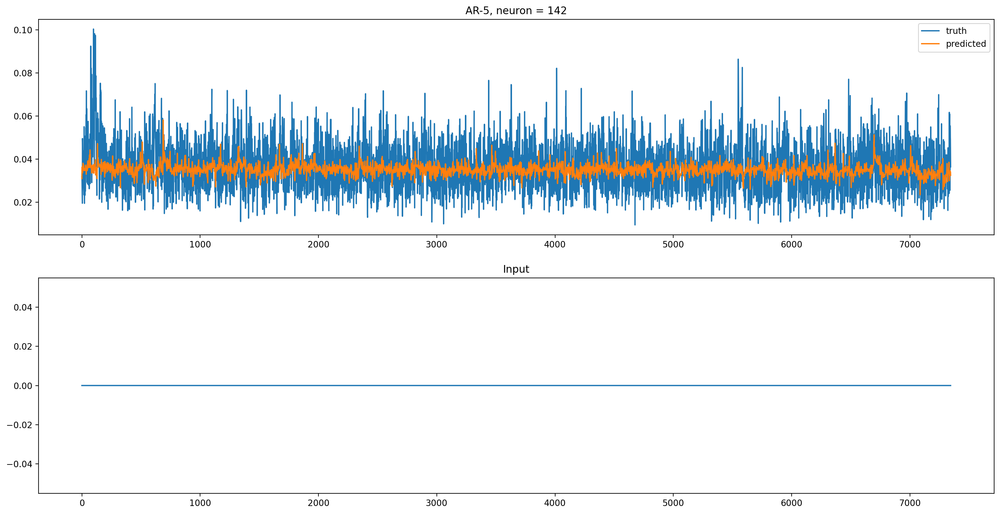

-------------------------------------------------


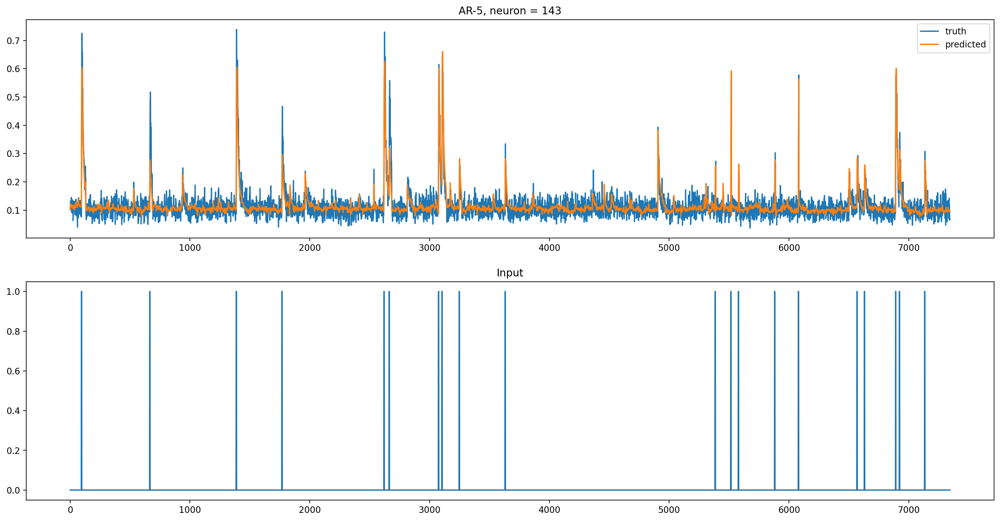

-------------------------------------------------


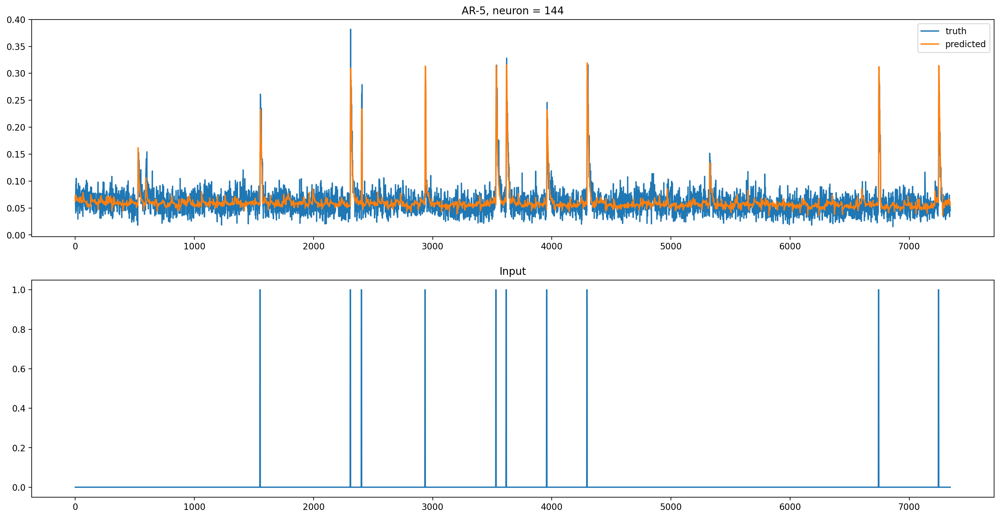

-------------------------------------------------


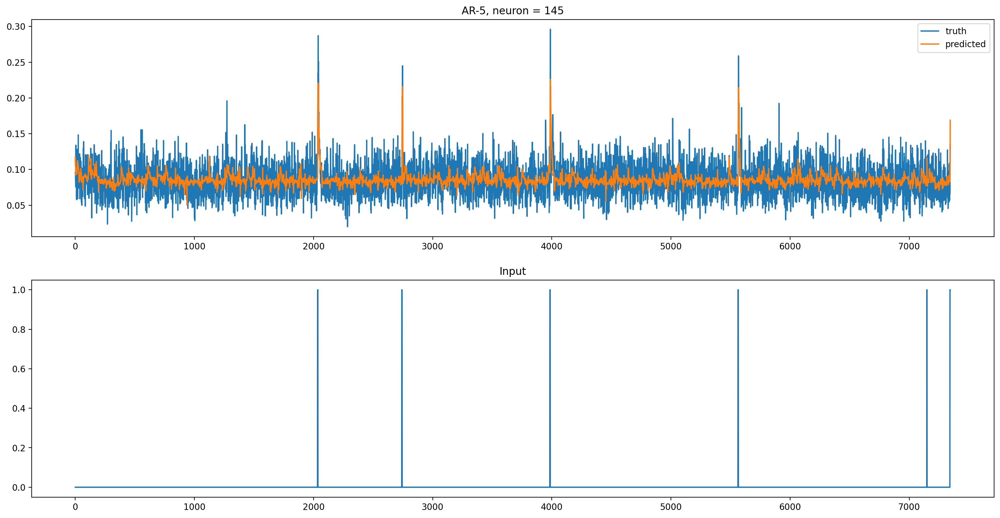

-------------------------------------------------


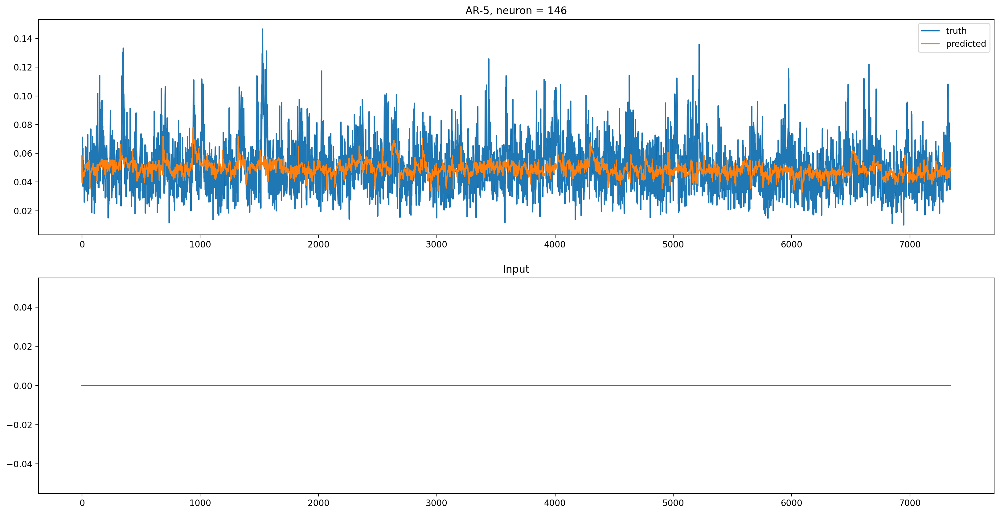

-------------------------------------------------


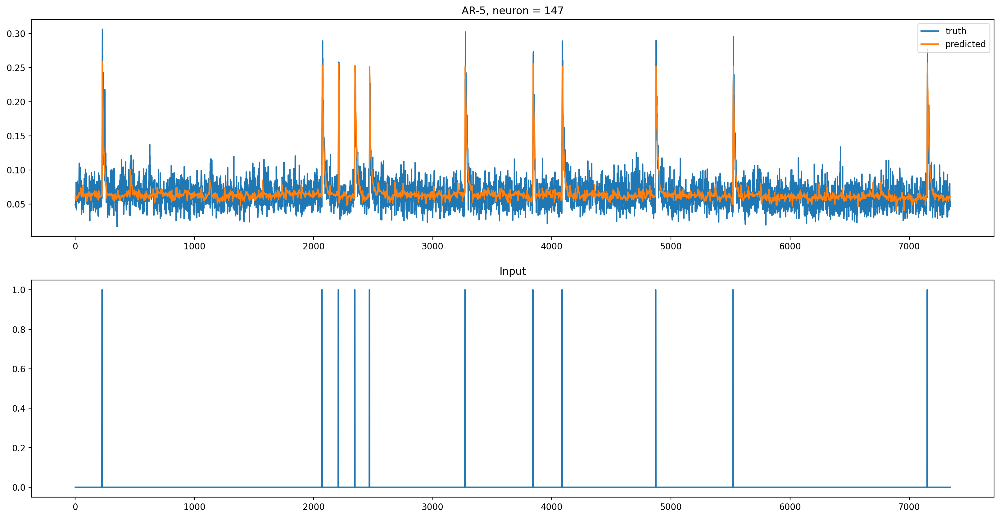

-------------------------------------------------


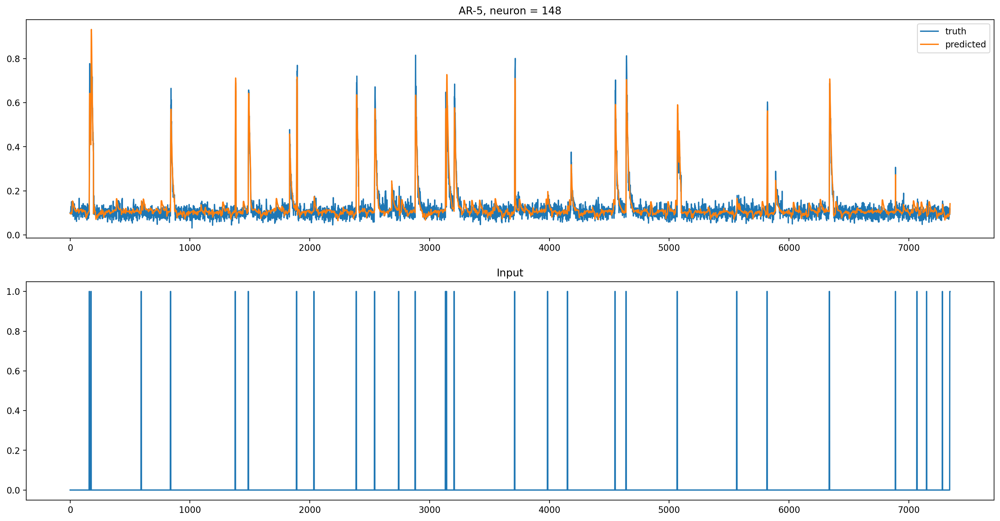

-------------------------------------------------


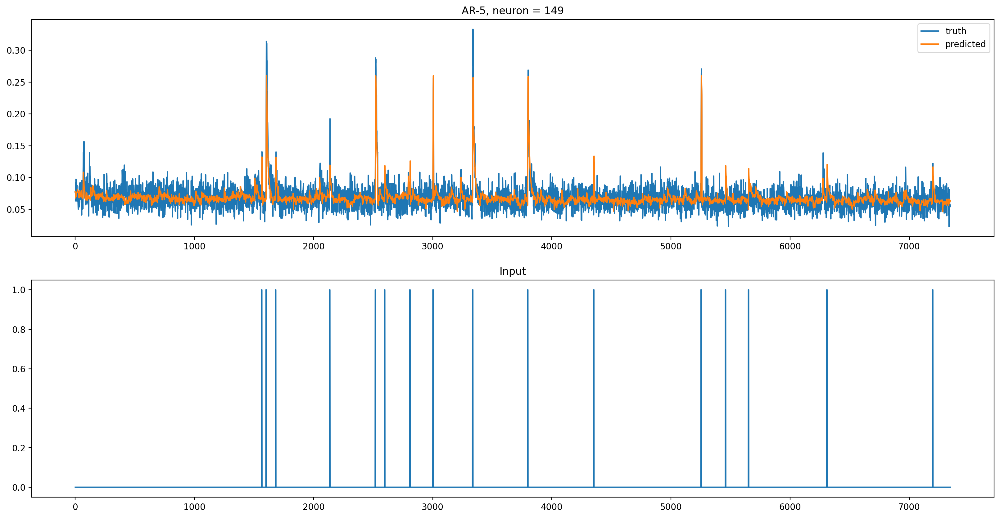

-------------------------------------------------


In [105]:
neuron = 17
length = 10000



for neuron in np.linspace(100,149,50).astype(int):
    output_pred = []
    output_true = []
    input_true = []
    segment_marker = []
    for i in range(np.min([len(x_true),length])):
        output_pred.extend(x_pred[i][:,neuron])
        #output_pred.append(np.nan)
        output_true.extend(x_true[i][:,neuron])
        #output_true.append(np.nan)
        input_true.extend(u_true[i][:,neuron])
        #input_true.append(np.nan)
        segment_marker.extend(np.nan*np.zeros(len(x_pred[i][:,neuron])-1))
        segment_marker.extend([0.25,0])

    plt.figure(figsize=(20,10))
    plt.subplot(2,1,1)
    plt.plot(output_true,label='truth')
    plt.plot(output_pred,label='predicted')
    #plt.plot(segment_marker)
    plt.title('AR-5, neuron = ' + str(neuron))
    plt.legend()

    plt.subplot(2,1,2)
    plt.plot(input_true,label='input')
    plt.title('Input')
    plt.show()
    print('-------------------------------------------------')

In [106]:
# train_inputs = u_session.copy()
# test_inputs = u_session.copy()
# for t in range(len(train_indices)):
#     if train_indices[t]:
#         test_inputs[t,:] = 0
#     if test_indices[t]:
#         train_inputs[t,:] = 0

neuron = 148
print(np.sum(train_inputs[:,neuron]))
print(np.sum(test_inputs[:,neuron]))

242.0
85.0


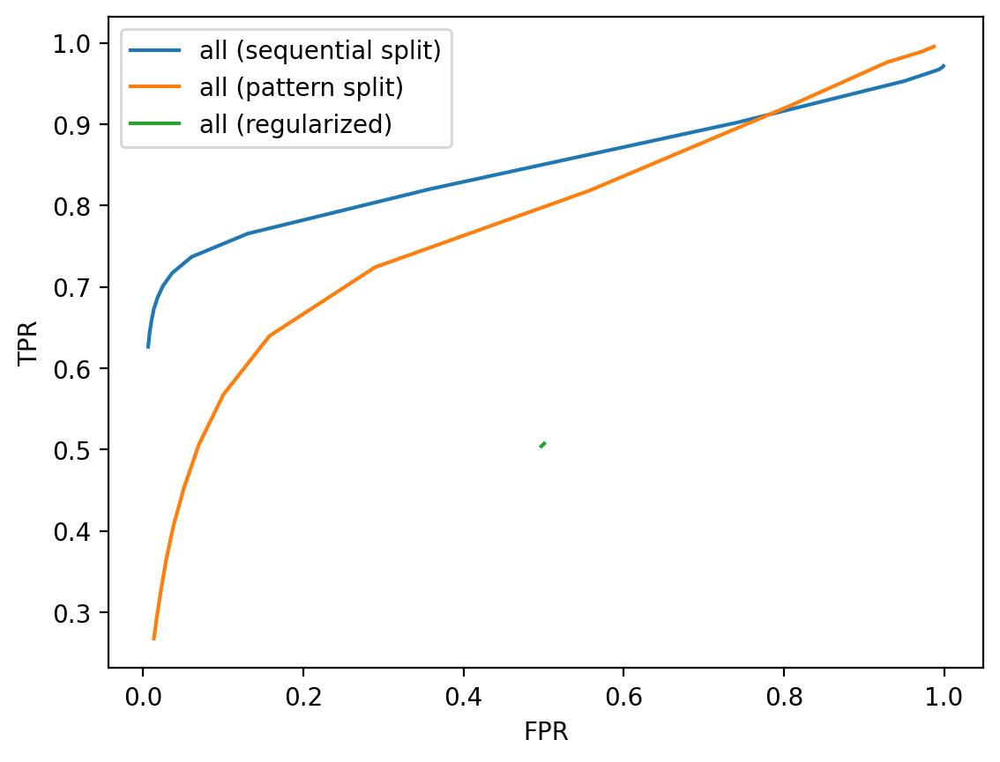

In [165]:
#tpr2, fpr2, tpr_noinput2, fpr_noinput2 = compute_roc(x_pred2,5,train_indices=train_indices,test_indices=test_indices2)
#tpr, fpr, tpr_noinput, fpr_noinput = compute_roc(x_pred,5,train_indices=train_indices,test_indices=test_indices)
#tpr_seq, fpr_seq, tpr_noinput_seq, fpr_noinput_seq = compute_roc(x_pred_seq,5,train_indices=train_indices_seq,test_indices=test_indices_seq)
tpr_reg, fpr_reg, tpr_reg_noinput, fpr_reg_noinput = compute_roc(x_pred_reg,5,train_indices=train_indices,test_indices=test_indices)

#plt.plot(fpr_noinput,tpr_noinput,label='unexcited')
#plt.plot(fpr,tpr,label='all')
#plt.plot(fpr_noinput_seq,tpr_noinput_seq,label='unexcited (sequential split)')
plt.plot(fpr_seq,tpr_seq,label='all (sequential split)')
#plt.plot(fpr_noinput2,tpr_noinput2,label='unexcited (pattern split)')
plt.plot(fpr2,tpr2,label='all (pattern split)')
plt.plot(fpr_reg,tpr_reg,label='all (regularized)')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()

[0.5001547802722818,
 0.5001249200073637,
 0.5000906765842925,
 0.500052871845222,
 0.5000126015796902,
 0.49998054973569556,
 0.4999484978917009,
 0.4999139805212452,
 0.49988083288771223,
 0.4998498768332559,
 0.4998164552523384,
 0.49978111603972897,
 0.499747968406196,
 0.499712355246202,
 0.4996789336652845]

# Analyzing connectivity

In [ ]:
ark_order = 5
X = []
Xp = []
train_indices_connect = np.ones(len(train_indices_seq)).astype(int)
for t in range(train_indices_connect.shape[0]-ark_order):
    if np.sum(train_indices_connect[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        X.append(np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
        Xp.append(y_session_interp[t+ark_order,:].copy().flatten() / 1000)
X = np.array(X)
Xp = np.array(Xp)
Ahat_connect = np.linalg.pinv(X.T @ X) @ X.T @ Xp
Ahat_connect = Ahat_connect.T

In [108]:
def compute_transfer_matrix(Ahat):
    k = 5
    avg_connect_ark = np.zeros((d,d))
    rollout_len = 1000
    params = []
    A_params = []
    B_params = []
    for i in range(k):
        params.append(np.zeros((d,d)))
        A_params.insert(0,Ahat[:,i*d:(i+1)*d])
        B_params.insert(0,Ahat[:,d*k+i*d:d*k+(i+1)*d])

    for t in range(rollout_len):
        param_new = np.zeros((d,d))
        for i in range(k):
            param_new += A_params[i] @ params[i]
        if t <= k-1:
            param_new += B_params[t]
        params = params[:-1]
        params.insert(0,param_new)
        avg_connect_ark += params[0]
    return avg_connect_ark


num_neurons = 663
d = num_neurons
Ast_new = np.zeros((num_neurons,10*num_neurons+1))
for i in range(10):
    Ast_new[:,i*num_neurons:(i+1)*num_neurons] = Ahat[0:num_neurons,i*d:i*d+num_neurons]
Ast_new[:,-1] = Ahat[0:num_neurons,-1]
transfer_gt = compute_transfer_matrix(Ast_new)

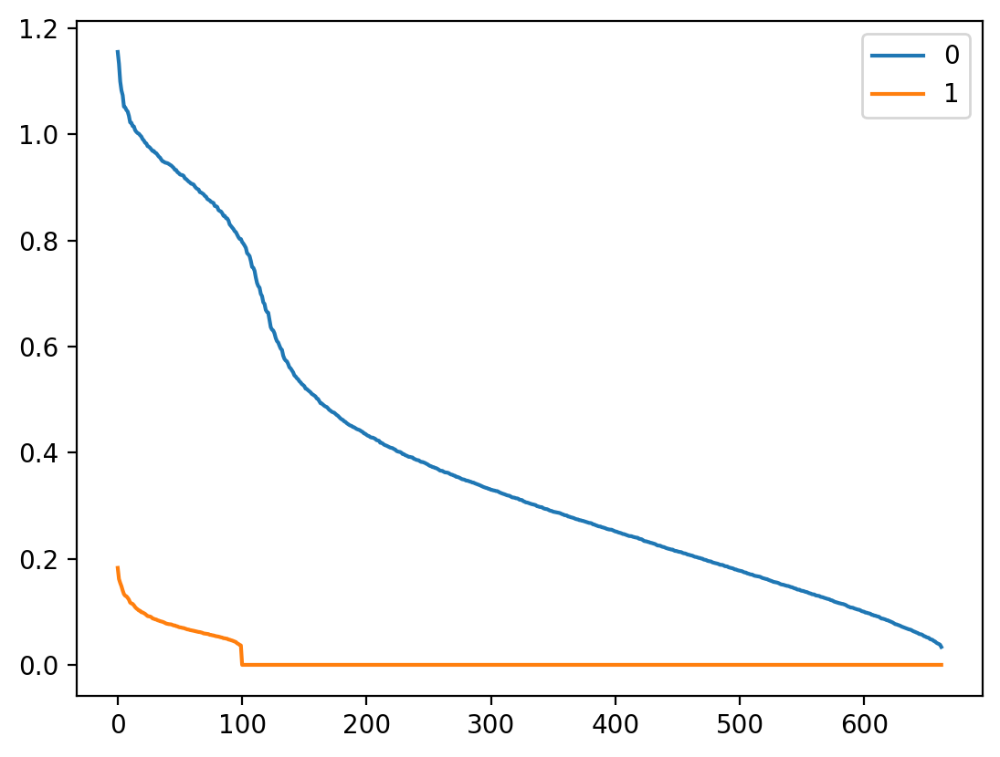

In [127]:
#_,S,_ = np.linalg.svd(transfer_gt)
#plt.plot(S)

for i in range(2*ark_order):
    A = Ahat_connect[0:num_neurons,i*d:i*d+num_neurons]
    _,S,_ = np.linalg.svd(A)
    if i < ark_order:
        lab_string = 'A-' + str(i)
    else:
        lab_string = 'B-' + str(i-ark_order)
    plt.plot(S, label=lab_string)
plt.legend()

(1327, 1327)


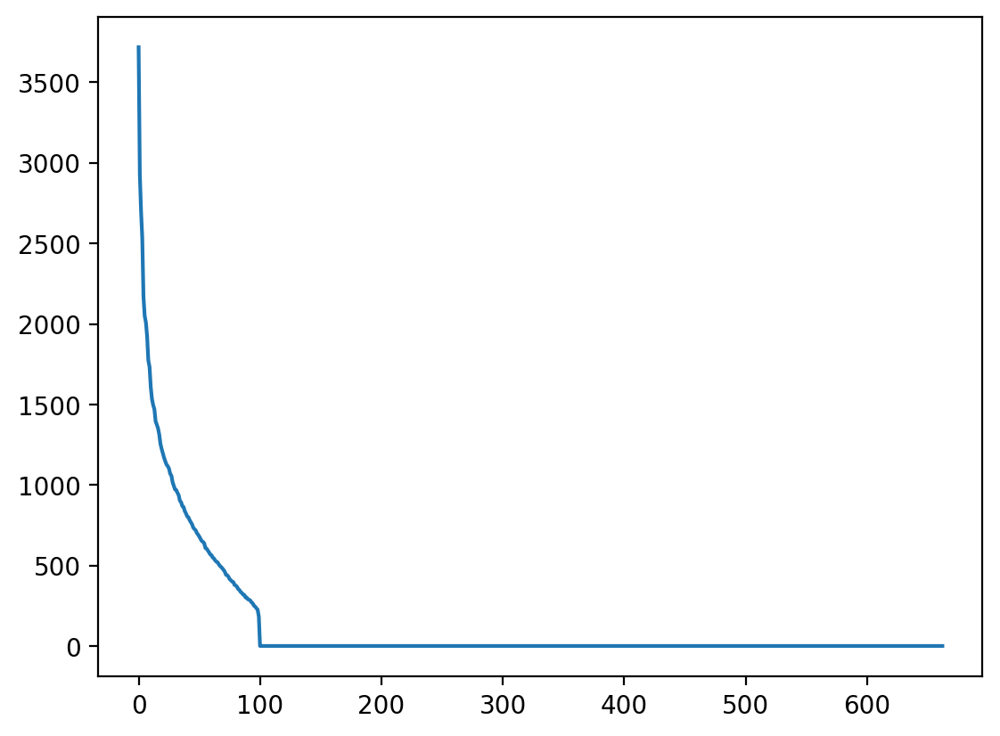

In [133]:
#cov = X.T @ X
print(cov.shape)
_,S,_ = np.linalg.svd(cov[663:2*663,663:2*663])
plt.plot(S)

# Regularized regression

In [143]:
np.sum(np.diag(transfer_gt))/len(np.diag(transfer_gt))

0.11266778515900078

In [146]:
from torch.utils.data import Dataset, DataLoader
class ARkDataset(Dataset):
    def __init__(self, outputs, inputs, train_indices, ark_order):
        X = []
        Xp = []
        for t in range(train_indices.shape[0]-ark_order):
            if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
                X.append(np.concatenate((outputs[t:t+ark_order,:].copy().flatten() / 1000, inputs[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
                Xp.append(outputs[t+ark_order,:].copy().flatten() / 1000)
        self.X = torch.tensor(X, device='cuda:0').float()
        self.Y = torch.tensor(Xp, device='cuda:0').float()
    
    def __len__(self):
        return self.X.shape[0]
    
    def __getitem__(self, idx):
        X_samp = self.X[idx,:]
        Y_samp = self.Y[idx,:]
        return X_samp, Y_samp

In [147]:
def compute_transfer_matrix_torch(Ahat):
    k = 5
    avg_connect_ark = torch.zeros((d,d))
    rollout_len = 10
    params = []
    A_params = []
    B_params = []
    for i in range(k):
        params.append(torch.zeros((d,d)))
        A_params.insert(0,Ahat[:,i*d:(i+1)*d])
        B_params.insert(0,Ahat[:,d*k+i*d:d*k+(i+1)*d])

    for t in range(rollout_len):
        param_new = torch.zeros((d,d))
        for i in range(k):
            param_new += A_params[i] @ params[i]
        if t <= k-1:
            param_new += B_params[t]
        params = params[:-1]
        params.insert(0,param_new)
        avg_connect_ark += params[0]
    return avg_connect_ark

0 23642.55078125
1 64451.76953125
2 19569.5390625
3 21060.837890625
4 36397.859375
5 26172.15625
6 10179.0185546875
7 8833.5849609375
8 17829.462890625
9 20176.017578125
10 12930.1376953125
11 5879.99609375
12 6088.7490234375
13 10453.0693359375
14 11857.763671875
15 8722.162109375
16 5179.68994140625
17 4694.15234375
18 6336.154296875
19 7156.62255859375
20 6125.7626953125
21 4632.20556640625
22 4085.59423828125
23 4353.48828125
24 4553.92333984375
25 4319.14697265625
26 3899.7353515625
27 3550.019287109375
28 3311.80029296875
29 3209.815185546875
30 3237.663330078125
31 3216.775390625
32 2978.11376953125
33 2659.078369140625
34 2547.208740234375
35 2646.576171875
36 2665.464599609375
37 2466.0009765625
38 2251.7275390625
39 2220.15673828125
40 2276.609619140625
41 2233.63818359375
42 2102.357177734375
43 2017.8721923828125
44 2005.7906494140625
45 1986.9315185546875
46 1934.6263427734375
47 1887.3880615234375
48 1853.6038818359375
49 1812.841064453125
50 1776.0830078125
51 1760.99499

387 624.1680908203125
388 623.4482421875
389 622.730224609375
390 622.013916015625
391 621.2996215820312
392 620.5868530273438
393 619.8760375976562
394 619.1668701171875
395 618.45947265625
396 617.7538452148438
397 617.0499267578125
398 616.34765625
399 615.6470947265625
400 614.9481811523438
401 614.2509155273438
402 613.5552978515625
403 612.861328125
404 612.1689453125
405 611.4782104492188
406 610.7890014648438
407 610.1014404296875
408 609.4154052734375
409 608.73095703125
410 608.0478515625
411 607.3665161132812
412 606.6866455078125
413 606.0081787109375
414 605.331298828125
415 604.6558227539062
416 603.9818725585938
417 603.3092651367188
418 602.6383056640625
419 601.9686889648438
420 601.3003540039062
421 600.6336059570312
422 599.9682006835938
423 599.30419921875
424 598.6414794921875
425 597.9802856445312
426 597.3203125
427 596.6616821289062
428 596.0045166015625
429 595.3486328125
430 594.6939697265625
431 594.0407104492188
432 593.3887329101562
433 592.738037109375
434

765 417.5799560546875
766 417.13189697265625
767 416.684326171875
768 416.23712158203125
769 415.7901611328125
770 415.34368896484375
771 414.89752197265625
772 414.45172119140625
773 414.0063171386719
774 413.5612487792969
775 413.1166076660156
776 412.6722106933594
777 412.2283020019531
778 411.78466796875
779 411.3414306640625
780 410.89849853515625
781 410.4560241699219
782 410.0138854980469
783 409.57208251953125
784 409.1306457519531
785 408.6896057128906
786 408.2488708496094
787 407.80853271484375
788 407.3684997558594
789 406.9288635253906
790 406.4895324707031
791 406.0506591796875
792 405.6120910644531
793 405.1739196777344
794 404.7360534667969
795 404.2985534667969
796 403.8614196777344
797 403.4246520996094
798 402.9881896972656
799 402.5521545410156
800 402.116455078125
801 401.68109130859375
802 401.24615478515625
803 400.8114929199219
804 400.377197265625
805 399.9432678222656
806 399.5096740722656
807 399.0765075683594
808 398.6436767578125
809 398.2111511230469
810 3

1134 275.9930114746094
1135 275.2686462402344
1136 274.9606628417969
1137 274.9118347167969
1138 274.4931945800781
1139 273.9219665527344
1140 273.6779479980469
1141 273.5138244628906
1142 273.076171875
1143 272.61676025390625
1144 272.3854064941406
1145 272.14202880859375
1146 271.7181396484375
1147 271.3310852050781
1148 271.0876159667969
1149 270.7974548339844
1150 270.3988342285156
1151 270.0532531738281
1152 269.7907409667969
1153 269.47723388671875
1154 269.103515625
1155 268.7789001464844
1156 268.4992370605469
1157 268.17669677734375
1158 267.8228454589844
1159 267.507568359375
1160 267.2154235839844
1161 266.8912353515625
1162 266.5516052246094
1163 266.2397766113281
1164 265.93963623046875
1165 265.6171569824219
1166 265.287109375
1167 264.9762878417969
1168 264.67156982421875
1169 264.3518981933594
1170 264.0283508300781
1171 263.7176513671875
1172 263.4106140136719
1173 263.09381103515625
1174 262.77471923828125
1175 262.4641418457031
1176 262.1561584472656
1177 261.8418884

1488 205.72698974609375
1489 206.1298065185547
1490 202.72732543945312
1491 200.8552703857422
1492 201.20126342773438
1493 198.8650665283203
1494 194.74449157714844
1495 195.93399047851562
1496 203.4856719970703
1497 211.58624267578125
1498 216.52835083007812
1499 217.8943328857422
1500 214.78875732421875
1501 207.07528686523438
1502 200.5492401123047
1503 202.92874145507812
1504 212.32998657226562
1505 219.3144073486328
1506 218.93899536132812
1507 215.6819610595703
1508 216.22128295898438
1509 219.592529296875
1510 218.52392578125
1511 210.54241943359375
1512 203.52886962890625
1513 205.7480926513672
1514 214.00247192382812
1515 217.13070678710938
1516 212.19589233398438
1517 209.07810974121094
1518 215.47598266601562
1519 225.3043212890625
1520 225.35313415527344
1521 213.0254364013672
1522 202.11407470703125
1523 203.5071563720703
1524 210.8431854248047
1525 212.67648315429688
1526 207.1600799560547
1527 201.4768829345703
1528 201.18995666503906
1529 205.23056030273438
1530 210.174

1839 191.29067993164062
1840 180.7471160888672
1841 184.74813842773438
1842 196.95028686523438
1843 199.2860107421875
1844 188.37835693359375
1845 178.12567138671875
1846 179.8214874267578
1847 188.2530517578125
1848 189.28135681152344
1849 178.98013305664062
1850 168.46559143066406
1851 168.01510620117188
1852 176.31317138671875
1853 185.67416381835938
1854 191.1423797607422
1855 192.33102416992188
1856 190.3042449951172
1857 188.855224609375
1858 193.85836791992188
1859 205.13465881347656
1860 213.57090759277344
1861 212.27967834472656
1862 205.00613403320312
1863 199.5063934326172
1864 198.1434326171875
1865 195.86671447753906
1866 189.71432495117188
1867 185.7989959716797
1868 188.45042419433594
1869 192.50877380371094
1870 189.369873046875
1871 179.0408935546875
1872 171.8306884765625
1873 174.62142944335938
1874 185.23341369628906
1875 196.97314453125
1876 203.15023803710938
1877 200.554931640625
1878 193.56076049804688
1879 192.95120239257812
1880 202.17869567871094
1881 210.344

2190 144.59400939941406
2191 151.72219848632812
2192 150.73068237304688
2193 142.15516662597656
2194 135.50160217285156
2195 138.5884246826172
2196 146.3576202392578
2197 148.56053161621094
2198 144.781494140625
2199 142.3079071044922
2200 143.92068481445312
2201 145.48031616210938
2202 146.52549743652344
2203 153.90625
2204 168.42868041992188
2205 177.28652954101562
2206 169.0187225341797
2207 153.03414916992188
2208 150.3871307373047
2209 162.46173095703125
2210 168.95994567871094
2211 158.85740661621094
2212 145.748046875
2213 147.2799072265625
2214 157.8538818359375
2215 158.8292694091797
2216 149.46070861816406
2217 145.97657775878906
2218 154.42530822753906
2219 163.0885009765625
2220 163.4415283203125
2221 160.48016357421875
2222 157.41273498535156
2223 148.70199584960938
2224 135.38031005859375
2225 130.89430236816406
2226 143.16810607910156
2227 161.39015197753906
2228 169.7927703857422
2229 167.77032470703125
2230 164.59828186035156
2231 161.70188903808594
2232 155.8134307861

2541 103.65362548828125
2542 106.85537719726562
2543 111.05865478515625
2544 117.0289306640625
2545 124.73460388183594
2546 129.92335510253906
2547 125.83960723876953
2548 112.87565612792969
2549 101.76535034179688
2550 101.5014877319336
2551 109.31702423095703
2552 115.51777648925781
2553 115.75563049316406
2554 115.46197509765625
2555 120.68263244628906
2556 127.48780059814453
2557 127.1450424194336
2558 120.36894226074219
2559 116.11448669433594
2560 117.76229095458984
2561 120.09703826904297
2562 117.84317016601562
2563 113.32766723632812
2564 114.06534576416016
2565 120.35074615478516
2566 123.36843872070312
2567 119.056396484375
2568 114.69852447509766
2569 119.45654296875
2570 132.48561096191406
2571 143.48153686523438
2572 143.67794799804688
2573 133.9075927734375
2574 123.1613540649414
2575 120.69188690185547
2576 126.93807983398438
2577 132.7468719482422
2578 130.6347198486328
2579 123.84784698486328
2580 122.87690734863281
2581 133.4095001220703
2582 147.97479248046875
2583 

2892 90.21662902832031
2893 97.78419494628906
2894 105.5715560913086
2895 113.25921630859375
2896 120.83626556396484
2897 125.05982208251953
2898 121.02810668945312
2899 110.1396713256836
2900 101.51716613769531
2901 101.23300170898438
2902 106.73049926757812
2903 112.12041473388672
2904 113.45340728759766
2905 109.35765075683594
2906 102.34728240966797
2907 99.6858901977539
2908 105.87317657470703
2909 115.2955093383789
2910 117.40977478027344
2911 110.47652435302734
2912 104.63961791992188
2913 108.15827178955078
2914 115.75755310058594
2915 116.73318481445312
2916 112.70414733886719
2917 113.836181640625
2918 120.85696411132812
2919 124.6424331665039
2920 120.33937072753906
2921 113.87608337402344
2922 111.26990509033203
2923 109.67871856689453
2924 105.26908111572266
2925 101.41978454589844
2926 103.69532012939453
2927 109.19534301757812
2928 110.20686340332031
2929 107.06531524658203
2930 106.9723129272461
2931 114.35199737548828
2932 126.3914566040039
2933 137.4238739013672
2934 

3243 84.93659973144531
3244 85.52447509765625
3245 84.53057861328125
3246 81.23460388183594
3247 78.17843627929688
3248 75.5488052368164
3249 71.61631774902344
3250 68.04064178466797
3251 68.77241516113281
3252 75.14925384521484
3253 84.2475814819336
3254 92.16424560546875
3255 98.6871337890625
3256 104.55786895751953
3257 105.79865264892578
3258 98.5411148071289
3259 88.20491790771484
3260 84.58580017089844
3261 89.2654800415039
3262 95.07108306884766
3263 96.64707946777344
3264 96.00670623779297
3265 96.10372924804688
3266 94.92788696289062
3267 91.45130157470703
3268 91.35736083984375
3269 99.74082946777344
3270 113.3189468383789
3271 123.2904052734375
3272 125.44319152832031
3273 124.396240234375
3274 123.67073822021484
3275 118.77386474609375
3276 106.65054321289062
3277 96.6906967163086
3278 102.2124252319336
3279 121.56392669677734
3280 136.9706268310547
3281 133.6190185546875
3282 115.73303985595703
3283 102.35726928710938
3284 107.96481323242188
3285 128.92947387695312
3286 14

3594 76.2779541015625
3595 67.3381576538086
3596 59.35190200805664
3597 59.21561050415039
3598 65.13057708740234
3599 69.99745178222656
3600 70.95707702636719
3601 69.66741943359375
3602 66.26536560058594
3603 60.32829666137695
3604 56.39409255981445
3605 59.98099899291992
3606 69.4825668334961
3607 77.5978012084961
3608 80.83389282226562
3609 84.24158477783203
3610 91.56411743164062
3611 96.81167602539062
3612 92.88951873779297
3613 83.43450164794922
3614 79.87779998779297
3615 86.63838195800781
3616 94.86346435546875
3617 94.64619445800781
3618 88.827880859375
3619 87.57231140136719
3620 92.83463287353516
3621 97.39159393310547
3622 96.2986068725586
3623 93.88134765625
3624 97.73050689697266
3625 107.748291015625
3626 116.29963684082031
3627 117.61298370361328
3628 115.27155303955078
3629 117.95166015625
3630 125.33440399169922
3631 126.37016296386719
3632 115.42363739013672
3633 103.34400939941406
3634 105.24986267089844
3635 118.46603393554688
3636 123.55801391601562
3637 110.24059

3945 89.27597045898438
3946 90.73487091064453
3947 90.4932632446289
3948 82.86389923095703
3949 74.52830505371094
3950 73.54330444335938
3951 75.7136459350586
3952 71.18635559082031
3953 60.827335357666016
3954 57.386680603027344
3955 66.81561279296875
3956 76.52162170410156
3957 71.32960510253906
3958 55.76224899291992
3959 49.1890754699707
3960 59.28240203857422
3961 73.0252914428711
3962 76.99687194824219
3963 74.7777328491211
3964 76.87189483642578
3965 81.36902618408203
3966 77.52415466308594
3967 66.00234985351562
3968 61.930606842041016
3969 74.462646484375
3970 92.48100280761719
3971 96.99083709716797
3972 84.94709777832031
3973 73.50835418701172
3974 77.43384552001953
3975 90.57807922363281
3976 95.0219497680664
3977 84.02716064453125
3978 70.49351501464844
3979 70.48788452148438
3980 85.10236358642578
3981 101.62359619140625
3982 107.28443908691406
3983 100.00128936767578
3984 86.9979476928711
3985 77.29621887207031
3986 76.2683334350586
3987 84.43804931640625
3988 97.4496307

4299 80.6816635131836
4300 70.3162841796875
4301 70.91803741455078
4302 77.67491912841797
4303 75.91548156738281
4304 63.65471267700195
4305 55.429466247558594
4306 61.11235046386719
4307 72.26509857177734
4308 74.62664031982422
4309 67.24369812011719
4310 61.98040008544922
4311 65.89268493652344
4312 74.20196533203125
4313 79.68046569824219
4314 80.52117156982422
4315 78.7684555053711
4316 76.63629913330078
4317 74.74314880371094
4318 72.3808364868164
4319 70.09649658203125
4320 69.14546203613281
4321 70.02436828613281
4322 72.44599914550781
4323 74.13567352294922
4324 73.2142333984375
4325 70.19278717041016
4326 65.57664489746094
4327 60.5173225402832
4328 58.58237075805664
4329 63.23197555541992
4330 73.36205291748047
4331 81.6253433227539
4332 80.4103775024414
4333 71.42668914794922
4334 65.59246826171875
4335 70.2613525390625
4336 78.90312194824219
4337 79.85693359375
4338 73.523681640625
4339 70.49600219726562
4340 76.18321990966797
4341 86.59296417236328
4342 95.63394165039062
4

4653 79.93624877929688
4654 83.99884796142578
4655 84.84524536132812
4656 83.15384674072266
4657 83.6373062133789
4658 88.94245147705078
4659 95.99677276611328
4660 100.92696380615234
4661 102.77142333984375
4662 101.9313735961914
4663 98.16165924072266
4664 91.74813842773438
4665 85.76275634765625
4666 84.18829345703125
4667 87.2028579711914
4668 89.84033203125
4669 87.42147827148438
4670 81.54573059082031
4671 76.45063018798828
4672 71.74433898925781
4673 65.02007293701172
4674 58.99242401123047
4675 59.67473220825195
4676 66.87532043457031
4677 72.56194305419922
4678 71.72845458984375
4679 70.19306182861328
4680 76.28063201904297
4681 87.73336791992188
4682 94.18317413330078
4683 90.53020477294922
4684 83.20437622070312
4685 81.2742691040039
4686 83.0145034790039
4687 80.16905975341797
4688 73.08576202392578
4689 70.50830841064453
4690 75.83458709716797
4691 81.61856079101562
4692 80.35098266601562
4693 74.04197692871094
4694 69.03125762939453
4695 68.10551452636719
4696 70.00274658

5010 78.07321166992188
5011 87.4514389038086
5012 90.00662994384766
5013 83.8138427734375
5014 76.08248138427734
5015 75.03520202636719
5016 81.42801666259766
5017 86.94932556152344
5018 84.06481170654297
5019 75.61321258544922
5020 71.29163360595703
5021 76.80520629882812
5022 88.35099792480469
5023 96.5810775756836
5024 94.96534729003906
5025 85.30485534667969
5026 74.9812240600586
5027 70.93697357177734
5028 75.4851303100586
5029 84.34696960449219
5030 89.7781753540039
5031 85.08023834228516
5032 70.13406372070312
5033 54.93462371826172
5034 51.22040939331055
5035 60.131351470947266
5036 71.00543975830078
5037 73.0146484375
5038 67.3482894897461
5039 63.96981430053711
5040 67.47174835205078
5041 72.40080261230469
5042 72.94064331054688
5043 70.80220794677734
5044 71.03357696533203
5045 74.21959686279297
5046 77.09365844726562
5047 79.85309600830078
5048 85.51348876953125
5049 92.39614868164062
5050 94.78319549560547
5051 92.35501098632812
5052 91.06511688232422
5053 91.9358825683593

5367 62.723487854003906
5368 55.554847717285156
5369 52.169677734375
5370 53.697444915771484
5371 58.35150146484375
5372 63.09703826904297
5373 66.19609832763672
5374 67.20026397705078
5375 67.39105224609375
5376 68.40475463867188
5377 70.22940063476562
5378 71.87696075439453
5379 72.77230072021484
5380 72.99925231933594
5381 73.21281433105469
5382 75.33528900146484
5383 80.54297637939453
5384 85.96380615234375
5385 87.2954330444336
5386 84.85582733154297
5387 82.67622375488281
5388 83.22463989257812
5389 84.93312072753906
5390 84.29066467285156
5391 81.48206329345703
5392 80.01517486572266
5393 79.96222686767578
5394 78.18665313720703
5395 74.49982452392578
5396 72.5363540649414
5397 74.82928466796875
5398 80.30174255371094
5399 86.6288833618164
5400 92.81114959716797
5401 97.04340362548828
5402 95.85520935058594
5403 90.48886108398438
5404 87.92464447021484
5405 92.8545913696289
5406 101.86978912353516
5407 105.30863952636719
5408 96.81754302978516
5409 81.73663330078125
5410 74.0003

5724 66.1834487915039
5725 70.47274780273438
5726 73.93929290771484
5727 72.19316864013672
5728 68.80809020996094
5729 69.72662353515625
5730 74.2811279296875
5731 75.87687683105469
5732 72.34255981445312
5733 69.608642578125
5734 71.87628936767578
5735 76.1312484741211
5736 76.50261688232422
5737 69.66775512695312
5738 59.32221603393555
5739 52.73487091064453
5740 51.04413986206055
5741 49.509185791015625
5742 46.51786804199219
5743 46.27912139892578
5744 52.72116470336914
5745 63.42222595214844
5746 71.24317169189453
5747 72.39153289794922
5748 70.27252960205078
5749 69.06250762939453
5750 68.05062866210938
5751 66.57917022705078
5752 68.80147552490234
5753 78.754638671875
5754 93.79290008544922
5755 106.80596923828125
5756 113.22016906738281
5757 112.80795288085938
5758 108.0661849975586
5759 102.02233123779297
5760 96.74057006835938
5761 93.2587661743164
5762 91.35667419433594
5763 92.25137329101562
5764 96.8417739868164
5765 99.83355712890625
5766 94.23069763183594
5767 81.3854904

6081 79.39360046386719
6082 69.11415100097656
6083 62.04457473754883
6084 61.92839813232422
6085 61.91756057739258
6086 56.521732330322266
6087 49.978336334228516
6088 48.314842224121094
6089 50.95915985107422
6090 54.251461029052734
6091 57.1135368347168
6092 60.271812438964844
6093 62.785484313964844
6094 63.67070770263672
6095 65.23411560058594
6096 69.99344635009766
6097 75.48407745361328
6098 76.21678161621094
6099 69.50423431396484
6100 59.1703987121582
6101 52.386627197265625
6102 52.723167419433594
6103 58.95077896118164
6104 67.21783447265625
6105 73.1812515258789
6106 74.43627166748047
6107 73.78630828857422
6108 77.86145782470703
6109 88.33348846435547
6110 98.62482452392578
6111 99.48837280273438
6112 89.90684509277344
6113 81.94129943847656
6114 86.71188354492188
6115 99.91835021972656
6116 106.53121185302734
6117 97.04389190673828
6118 78.9225082397461
6119 70.650634765625
6120 80.62805938720703
6121 96.58116912841797
6122 101.34443664550781
6123 91.92430877685547
6124 80

6438 64.98015594482422
6439 71.35575866699219
6440 62.791839599609375
6441 57.233768463134766
6442 66.20169067382812
6443 78.45166015625
6444 79.7364730834961
6445 73.22515106201172
6446 71.718505859375
6447 75.8808822631836
6448 74.26090240478516
6449 64.66277313232422
6450 58.90452575683594
6451 63.92488098144531
6452 71.92980194091797
6453 73.6153793334961
6454 71.04534149169922
6455 70.3895034790039
6456 69.37879943847656
6457 62.88932800292969
6458 54.354698181152344
6459 52.351932525634766
6460 58.6268310546875
6461 64.76780700683594
6462 64.90715026855469
6463 63.91909408569336
6464 66.54942321777344
6465 69.06385803222656
6466 67.52729797363281
6467 67.00199890136719
6468 75.2125473022461
6469 88.35745239257812
6470 91.29629516601562
6471 77.74864196777344
6472 61.625003814697266
6473 60.47402572631836
6474 74.68994903564453
6475 88.56690979003906
6476 90.37596130371094
6477 84.67322540283203
6478 82.60883331298828
6479 86.94644165039062
6480 90.83345794677734
6481 87.681709289

6795 80.30219268798828
6796 77.52019500732422
6797 71.12881469726562
6798 69.34082794189453
6799 73.67716979980469
6800 77.95433044433594
6801 76.66741943359375
6802 70.7676010131836
6803 63.31523513793945
6804 55.61107635498047
6805 49.55122375488281
6806 48.089237213134766
6807 51.31087112426758
6808 54.899574279785156
6809 55.86608123779297
6810 57.00041961669922
6811 61.730655670166016
6812 68.11744689941406
6813 71.6198501586914
6814 71.76459503173828
6815 70.99234008789062
6816 69.1440658569336
6817 65.07401275634766
6818 60.01686477661133
6819 57.7615966796875
6820 61.46525192260742
6821 68.5032958984375
6822 74.59944152832031
6823 79.22373962402344
6824 82.075439453125
6825 81.15499114990234
6826 76.02315521240234
6827 71.5313491821289
6828 73.30722045898438
6829 79.80470275878906
6830 85.06400299072266
6831 85.0699691772461
6832 79.6869125366211
6833 72.09677124023438
6834 67.15181732177734
6835 68.1281967163086
6836 73.63204193115234
6837 79.40335845947266
6838 82.23550415039

7155 86.41016387939453
7156 88.21223449707031
7157 86.45590209960938
7158 80.49080657958984
7159 72.9209976196289
7160 67.22403717041016
7161 64.48065948486328
7162 64.66571044921875
7163 66.91818237304688
7164 68.61760711669922
7165 68.54021453857422
7166 67.15913391113281
7167 63.38290786743164
7168 56.44855499267578
7169 49.68448257446289
7170 48.101593017578125
7171 52.41364669799805
7172 57.39274215698242
7173 58.14259719848633
7174 57.10907745361328
7175 62.001869201660156
7176 75.20384979248047
7177 88.3373031616211
7178 91.8092041015625
7179 86.49178314208984
7180 81.5969467163086
7181 83.00824737548828
7182 88.29908752441406
7183 92.07188415527344
7184 90.23197937011719
7185 82.5475845336914
7186 73.89024353027344
7187 68.82362365722656
7188 68.72624206542969
7189 71.91727447509766
7190 72.9713363647461
7191 67.88316345214844
7192 59.22749710083008
7193 54.158321380615234
7194 57.58311462402344
7195 67.63848876953125
7196 79.79609680175781
7197 92.29603576660156
7198 104.17729

7512 70.85570526123047
7513 66.6764144897461
7514 69.434326171875
7515 74.37710571289062
7516 77.90922546386719
7517 78.65111541748047
7518 76.20426177978516
7519 70.11741638183594
7520 62.04357147216797
7521 57.47162628173828
7522 60.024478912353516
7523 66.80724334716797
7524 72.84651184082031
7525 75.97347259521484
7526 76.19041442871094
7527 74.20657348632812
7528 70.9800033569336
7529 67.92780303955078
7530 66.10749053955078
7531 65.13507843017578
7532 65.50570678710938
7533 69.2529296875
7534 75.75809478759766
7535 81.78034210205078
7536 86.33721160888672
7537 90.3381118774414
7538 91.73626708984375
7539 86.4049072265625
7540 75.1654052734375
7541 64.9916000366211
7542 61.38138198852539
7543 63.35846710205078
7544 66.39937591552734
7545 68.34416961669922
7546 71.38529968261719
7547 76.31214904785156
7548 79.10120391845703
7549 76.85964965820312
7550 72.53153228759766
7551 71.85303497314453
7552 76.21382141113281
7553 80.42919158935547
7554 78.90306854248047
7555 71.5928955078125


7872 83.57461547851562
7873 91.59400177001953
7874 97.01346588134766
7875 88.95922088623047
7876 74.55806732177734
7877 70.39378356933594
7878 81.35079956054688
7879 95.63508605957031
7880 100.55406188964844
7881 95.83943939208984
7882 89.30982208251953
7883 84.80596160888672
7884 79.48966217041016
7885 71.59062957763672
7886 65.75433349609375
7887 67.50782775878906
7888 74.47187042236328
7889 77.91461181640625
7890 74.3349609375
7891 69.1557846069336
7892 67.47144317626953
7893 68.44857788085938
7894 68.38150787353516
7895 65.9110336303711
7896 63.091094970703125
7897 61.536800384521484
7898 62.09102249145508
7899 66.1529541015625
7900 72.5849380493164
7901 76.6001205444336
7902 74.04884338378906
7903 66.82461547851562
7904 62.607975006103516
7905 68.06165313720703
7906 81.87181091308594
7907 94.55532836914062
7908 97.07222747802734
7909 88.30406951904297
7910 74.45563507080078
7911 64.45191192626953
7912 64.22283172607422
7913 71.4305419921875
7914 76.90884399414062
7915 73.656875610

8232 79.80337524414062
8233 78.66694641113281
8234 73.14013671875
8235 67.4061050415039
8236 64.61074829101562
8237 65.43610382080078
8238 69.2736587524414
8239 74.9530029296875
8240 79.80103302001953
8241 81.82246398925781
8242 79.6398696899414
8243 72.7994613647461
8244 64.12088775634766
8245 59.48210144042969
8246 63.33935546875
8247 71.39141845703125
8248 74.46179962158203
8249 71.38941955566406
8250 70.69519805908203
8251 78.87261962890625
8252 91.17652893066406
8253 97.43685913085938
8254 94.39783477783203
8255 88.1426010131836
8256 83.92124938964844
8257 79.75178527832031
8258 73.74944305419922
8259 69.7300796508789
8260 71.18621826171875
8261 73.64859008789062
8262 68.70233154296875
8263 56.96626663208008
8264 49.5356559753418
8265 54.02618408203125
8266 64.1536636352539
8267 66.95960235595703
8268 60.366764068603516
8269 56.544219970703125
8270 63.30635070800781
8271 71.89971923828125
8272 72.19035339355469
8273 68.79670715332031
8274 71.69121551513672
8275 78.9422607421875
82

8592 65.74382781982422
8593 58.87523651123047
8594 54.60007858276367
8595 56.987857818603516
8596 65.1781234741211
8597 73.00301361083984
8598 76.72135925292969
8599 79.18910217285156
8600 83.21491241455078
8601 85.25248718261719
8602 81.68248748779297
8603 75.90467071533203
8604 73.58430480957031
8605 74.86495971679688
8606 75.40145874023438
8607 73.5102310180664
8608 72.53423309326172
8609 74.69425964355469
8610 75.3947525024414
8611 68.73689270019531
8612 58.35944366455078
8613 54.551937103271484
8614 59.23813247680664
8615 62.850135803222656
8616 56.806644439697266
8617 45.352115631103516
8618 40.99708938598633
8619 46.78965759277344
8620 52.79969024658203
8621 50.87324905395508
8622 45.247310638427734
8623 46.73979568481445
8624 58.313446044921875
8625 71.72185516357422
8626 77.84335327148438
8627 75.15192413330078
8628 68.86428833007812
8629 65.28627014160156
8630 67.13433837890625
8631 72.79187774658203
8632 78.29511260986328
8633 78.45247650146484
8634 70.60480499267578
8635 61

8952 85.21733856201172
8953 81.02304077148438
8954 70.78072357177734
8955 60.426021575927734
8956 58.02779769897461
8957 65.21290588378906
8958 72.6624755859375
8959 69.88890075683594
8960 59.03496551513672
8961 53.27275466918945
8962 59.482940673828125
8963 67.50132751464844
8964 63.369895935058594
8965 49.07478332519531
8966 40.953330993652344
8967 47.35955047607422
8968 57.25284194946289
8969 57.38654327392578
8970 50.73245620727539
8971 50.13454055786133
8972 58.537353515625
8973 64.83761596679688
8974 61.397151947021484
8975 56.72521209716797
8976 64.05370330810547
8977 81.70158386230469
8978 92.8681869506836
8979 85.37670135498047
8980 67.46359252929688
8981 59.67494583129883
8982 71.84779357910156
8983 92.75936126708984
8984 102.6168212890625
8985 94.08666229248047
8986 80.08000946044922
8987 79.24226379394531
8988 95.08474731445312
8989 113.48951721191406
8990 118.01598358154297
8991 105.77029418945312
8992 90.29454803466797
8993 84.06962585449219
8994 83.00000762939453
8995 76

9309 66.27650451660156
9310 63.87388229370117
9311 69.6906509399414
9312 73.90827178955078
9313 68.62980651855469
9314 57.79409408569336
9315 51.276939392089844
9316 53.06220245361328
9317 58.802677154541016
9318 63.47898483276367
9319 65.72891998291016
9320 65.45411682128906
9321 63.705474853515625
9322 63.1956787109375
9323 65.87551879882812
9324 69.7691421508789
9325 70.6370620727539
9326 69.94363403320312
9327 72.3226547241211
9328 74.74677276611328
9329 70.55012512207031
9330 61.18451690673828
9331 55.170997619628906
9332 57.22411346435547
9333 62.66741180419922
9334 63.964542388916016
9335 61.091835021972656
9336 59.86117935180664
9337 62.22608947753906
9338 65.47650146484375
9339 68.87737274169922
9340 75.69438171386719
9341 86.53495788574219
9342 95.42256927490234
9343 96.47471618652344
9344 91.12545776367188
9345 86.63992309570312
9346 87.71936798095703
9347 91.78080749511719
9348 92.61387634277344
9349 86.83699798583984
9350 77.527099609375
9351 70.18070220947266
9352 67.4194

9666 66.48194122314453
9667 76.75536346435547
9668 85.47423553466797
9669 82.48013305664062
9670 69.47948455810547
9671 61.41719436645508
9672 67.89285278320312
9673 80.1710205078125
9674 82.21900939941406
9675 69.85953521728516
9676 55.93439865112305
9677 53.649044036865234
9678 59.170291900634766
9679 59.381629943847656
9680 50.92079544067383
9681 43.49215316772461
9682 44.70305252075195
9683 50.08428955078125
9684 52.16168212890625
9685 51.754093170166016
9686 55.4991455078125
9687 63.574459075927734
9688 68.88066864013672
9689 69.66381072998047
9690 72.45458221435547
9691 80.66241455078125
9692 87.03179168701172
9693 83.164306640625
9694 73.74030303955078
9695 72.70162200927734
9696 84.91925811767578
9697 100.40764617919922
9698 107.14781951904297
9699 103.26539611816406
9700 95.63687896728516
9701 90.35679626464844
9702 88.58349609375
9703 87.63175201416016
9704 82.58905792236328
9705 71.69788360595703
9706 61.17414093017578
9707 60.04098129272461
9708 69.05255126953125
9709 78.33

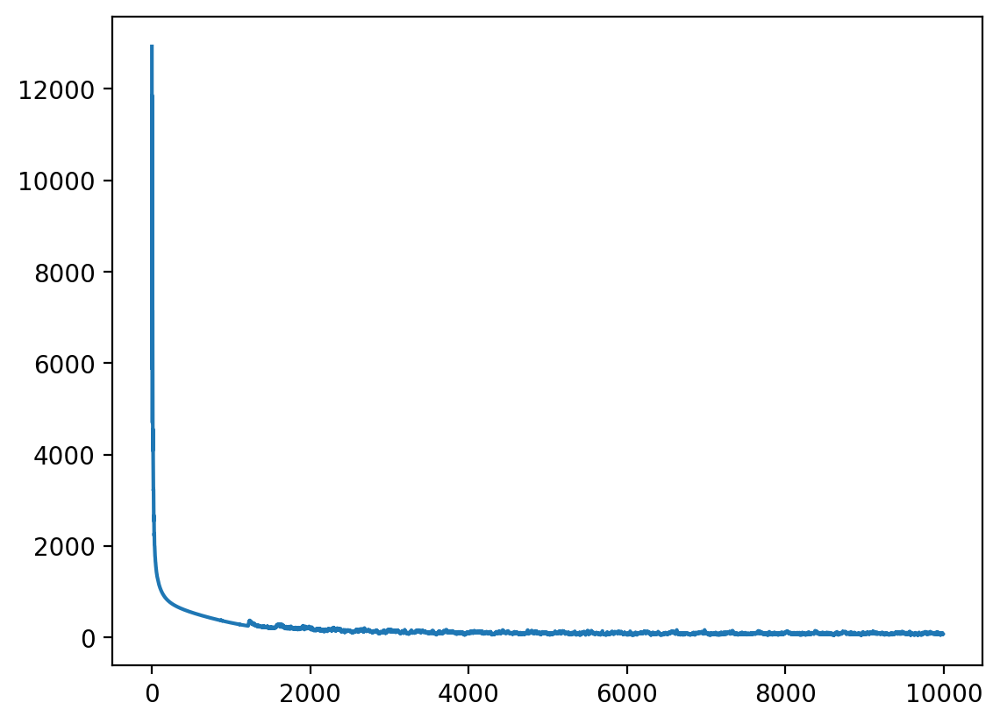

In [206]:
ark_order = 5
batch_size = 25000 #512
#data = ARkDataset(y_session_interp,u_session,train_indices,ark_order)
#data_loader = DataLoader(dataset=data, batch_size=batch_size, shuffle=True, drop_last=True)

# X = []
# Xp = []
# for t in range(train_indices.shape[0]-ark_order):
#     if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
#         X.append(np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1)))) 
#         Xp.append(y_session_interp[t+ark_order,:].copy().flatten() / 1000)
# X = torch.tensor(X, device='cuda:0').float()
# Xp = torch.tensor(Xp, device='cuda:0').float()

Ahat_reg = torch.randn(663,663*ark_order*2+1, device='cuda:0').float()
Ahat_reg.requires_grad_()
optimizer = optim.Adam([Ahat_reg], lr=0.05)

reg = 1
loss_vals = []
for n in range(10000):
    loss_epoch = 0
    #for x_batch, xp_batch in data_loader:
    if True:
        optimizer.zero_grad()
        loss = torch.linalg.norm(Xp.T - Ahat_reg @ X.T, ord='fro')**2 / X.shape[0]
        #loss = torch.linalg.norm(xp_batch.T - Ahat_reg @ x_batch.T, ord='fro')**2
        #loss += reg*torch.linalg.norm(Ahat_reg, ord='fro')**2
        #connect = compute_transfer_matrix_torch(Ahat_reg)
        #loss += reg * torch.linalg.norm(torch.diag(connect) - 0.1*torch.ones(663))**2
        loss_val = loss.item()
        loss.backward()
        optimizer.step()
        loss_vals.append(loss_val)
        loss_epoch += loss_val
    print(n,loss_epoch)

Ahat_reg = Ahat_reg.detach().cpu().numpy()
plt.plot(loss_vals[10:])
plt.show()

In [189]:
x_pred_reg = []
x_true_reg = []
u_true_reg = []
idx = -1

new_segment = True
segment_pred = []
segment_start = -1
for t in range(train_indices.shape[0]):
    if test_indices[t] == 1:
        if new_segment:
            segment_pred = []
            new_segment = False
            segment_start = t
            x_past = []
            x_pred_reg.append([])
            x_true_reg.append([])
            u_true_reg.append([])
            idx += 1
        if t < segment_start + ark_order:
            x_past.append(y_session_interp[t,:].copy().flatten() / 1000)
        else:
            z = np.array(x_past).flatten()
            z = np.concatenate((z,u_session[t-ark_order:t,:].copy().flatten(),np.ones(1)))
            x_next = Ahat_reg @ z
            x_past.pop(0)
            x_past.append(x_next.copy())
            x_pred_reg[idx].append(x_next.copy())
            x_true_reg[idx].append(y_session_interp[t,:].copy().flatten() / 1000)
            u_true_reg[idx].append(u_session[t,:].copy().flatten())
    else:
        new_segment = True

for i in range(len(x_pred_reg)):
    x_pred_reg[i] = np.array(x_pred_reg[i])
    x_true_reg[i] = np.array(x_true_reg[i])
    u_true_reg[i] = np.array(u_true_reg[i])

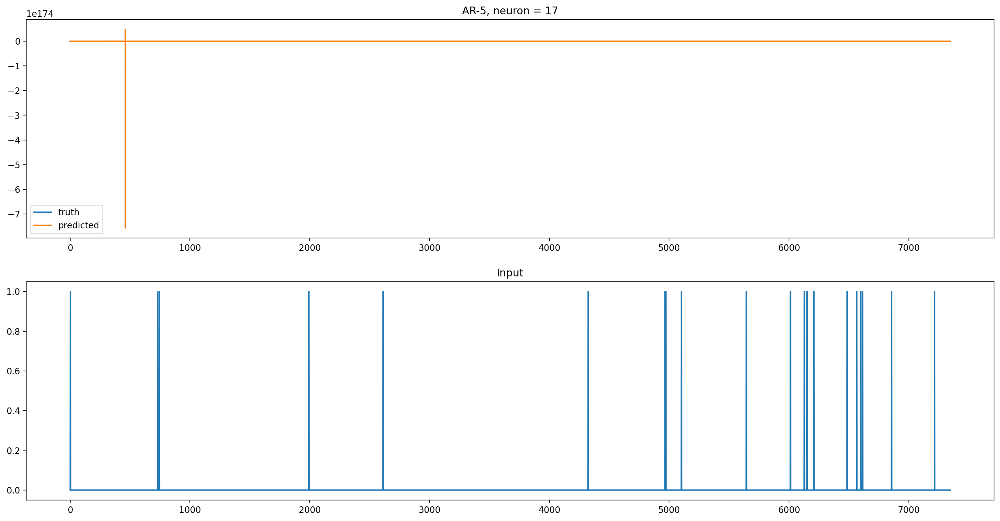

In [190]:
neuron = 17
length = 10000


output_pred = []
output_true = []
input_true = []
segment_marker = []
for i in range(np.min([len(x_true),length])):
    output_pred.extend(x_pred_reg[i][:,neuron])
    #output_pred.append(np.nan)
    output_true.extend(x_true[i][:,neuron])
    #output_true.append(np.nan)
    input_true.extend(u_true[i][:,neuron])
    #input_true.append(np.nan)
    #segment_marker.extend(np.nan*np.zeros(len(x_pred_reg[i][:,neuron])-1))
    #segment_marker.extend([0.25,0])

plt.figure(figsize=(20,10))
plt.subplot(2,1,1)
plt.plot(output_true,label='truth')
plt.plot(output_pred,label='predicted')
#plt.plot(segment_marker)
plt.title('AR-5, neuron = ' + str(neuron))
plt.legend()

plt.subplot(2,1,2)
plt.plot(input_true,label='input')
plt.title('Input')
plt.show()
    

In [191]:
print(np.linalg.norm(Ahat_reg),np.linalg.norm(Ahat),np.linalg.norm(Ahat_reg - Ahat))

1351.7548 15.176662916286379 1351.822804953242


In [207]:
train_residual = 0
for t in range(train_indices.shape[0]-ark_order):
    if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        z = np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1))) 
        y = y_session_interp[t+ark_order,:].copy().flatten() / 1000
        train_residual += np.linalg.norm(y - Ahat_reg @ z)**2
print(train_residual)

train_residual = 0
for t in range(train_indices.shape[0]-ark_order):
    if np.sum(train_indices[t:t+ark_order+1]) == ark_order + 1 and t > 5 + ark_order:
        z = np.concatenate((y_session_interp[t:t+ark_order,:].copy().flatten() / 1000, u_session[t:t+ark_order,:].copy().flatten(),np.ones(1))) 
        y = y_session_interp[t+ark_order,:].copy().flatten() / 1000
        train_residual += np.linalg.norm(y - Ahat @ z)**2
print(train_residual)

2040446.88797909
4846.130267147599


In [202]:
X.shape

torch.Size([25343, 6631])